In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_score, recall_score, f1_score


from sklearn.feature_selection import mutual_info_classif, f_classif
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder, StandardScaler

In [205]:
columns = [
    
    'checking_account_value',
    'duration',
    'credit_history',
    'credit_purpose',
    'credit_amount',
    'bonds',
    'present_employment_since',
    'rate_percentange_on_salary',
    'status_and_sex',
    'other_debtors',
    'present_residence_since',
    'property',
    'age',
    'Other_installment_plans',
    'housing',
    'n_bank_existing_credits',
    'job',
    'n_people_liable',
    'telephone',
    'foreign_worker',
    'credit_risk'
    
]

# Reading german.data - Transform Target - Create SEX

In [228]:
df = pd.read_csv("dataset/german.data", header=None, sep='\s')

df.columns = columns

df['credit_risk'] = df['credit_risk'].apply(lambda x: 0 if x == 2 else x)

def create_sex_column(x):
    if x in ['A91', 'A93', 'A94']:  # male
        return 1
    else:
        return 0    # female
    
df['sex'] = df.status_and_sex.apply(lambda x: create_sex_column(x))



df.head()

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\3096480883.py:1: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  df = pd.read_csv("dataset/german.data", header=None, sep='\s')


,checking_account_value,duration,credit_history,credit_purpose,credit_amount,bonds,present_employment_since,rate_percentange_on_salary,status_and_sex,other_debtors,...,age,Other_installment_plans,housing,n_bank_existing_credits,job,n_people_liable,telephone,foreign_worker,credit_risk,sex
0,A11,6,A34,A43,1169,A65,A75,4,A93,A101,...,67,A143,A152,2,A173,1,A192,A201,1,1
1,A12,48,A32,A43,5951,A61,A73,2,A92,A101,...,22,A143,A152,1,A173,1,A191,A201,0,0
2,A14,12,A34,A46,2096,A61,A74,2,A93,A101,...,49,A143,A152,1,A172,2,A191,A201,1,1
3,A11,42,A32,A42,7882,A61,A74,2,A93,A103,...,45,A143,A153,1,A173,2,A191,A201,1,1
4,A11,24,A33,A40,4870,A61,A73,3,A93,A101,...,53,A143,A153,2,A173,2,A191,A201,0,1


# Exploring Dataset

### Attributes Values

In [13]:
for col in df.select_dtypes(include=['object']).columns:
    print(col)
    print(df[col].unique())

checking_account_value
['A11' 'A12' 'A14' 'A13']
credit_history
['A34' 'A32' 'A33' 'A30' 'A31']
credit_purpose
['A43' 'A46' 'A42' 'A40' 'A41' 'A49' 'A44' 'A45' 'A410' 'A48']
bonds
['A65' 'A61' 'A63' 'A64' 'A62']
present_employment_since
['A75' 'A73' 'A74' 'A71' 'A72']
status_and_sex
['A93' 'A92' 'A91' 'A94']
other_debtors
['A101' 'A103' 'A102']
property
['A121' 'A122' 'A124' 'A123']
Other_installment_plans
['A143' 'A141' 'A142']
housing
['A152' 'A153' 'A151']
job
['A173' 'A172' 'A174' 'A171']
telephone
['A192' 'A191']
foreign_worker
['A201' 'A202']


In [14]:
pd.DataFrame(df.dtypes, columns=["data type"])

,data type
checking_account_value,object
duration,int64
credit_history,object
credit_purpose,object
credit_amount,int64
bonds,object
present_employment_since,object
rate_percentange_on_salary,int64
status_and_sex,object
other_debtors,object


In [15]:
df.describe()

,duration,credit_amount,rate_percentange_on_salary,present_residence_since,age,n_bank_existing_credits,n_people_liable,credit_risk,sex
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,20.903000,3271.258000,2.973000,2.845000,35.546000,1.407000,1.155000,0.700000,0.690000
std,12.058814,2822.736876,1.118715,1.103718,11.375469,0.577654,0.362086,0.458487,0.462725
min,4.000000,250.000000,1.000000,1.000000,19.000000,1.000000,1.000000,0.000000,0.000000
25%,12.000000,1365.500000,2.000000,2.000000,27.000000,1.000000,1.000000,0.000000,0.000000
50%,18.000000,2319.500000,3.000000,3.000000,33.000000,1.000000,1.000000,1.000000,1.000000
75%,24.000000,3972.250000,4.000000,4.000000,42.000000,2.000000,1.000000,1.000000,1.000000
max,72.000000,18424.000000,4.000000,4.000000,75.000000,4.000000,2.000000,1.000000,1.000000


### Checking the presence of NaN values

In [16]:
df.isna().any().any()

False

### SEX

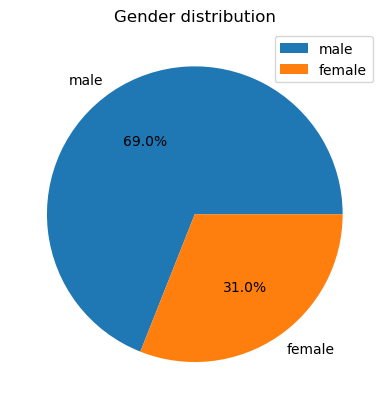

In [17]:
plt.pie(df["sex"].value_counts(), labels=['male', 'female'], autopct='%1.1f%%')
plt.legend()
plt.title("Gender distribution")
plt.show()

### Mapping Label to 1/0

In [18]:
df['credit_risk']  = df['credit_risk'].apply(lambda x: 0 if x == 2 else x)

### AIR for Dataset

In [19]:
# label_column must be a binary column with 1 as positive outcome and 0 as negative outcome
# protected_column must be a binary column

def adverse_impact_ratio_for_df(df, protected_column, protected_val, label_column):

        total_positive_protected = df[(df[protected_column] == protected_val) & (df[label_column] == 1)].shape[0]
        total_positive_unprotected = df[(df[protected_column] != protected_val) & (df[label_column] == 1)].shape[0]

        total_negative_protected = df[(df[protected_column] == protected_val) & (df[label_column] == 0)].shape[0]
        total_negative_unprotected = df[(df[protected_column] != protected_val) & (df[label_column] == 0)].shape[0]

        air_protected = total_positive_protected / (total_positive_protected + total_negative_protected)
        air_unprotected = total_positive_unprotected / (total_positive_unprotected + total_negative_unprotected)

        return air_protected / air_unprotected

### SME for Dataset

In [20]:
def standardized_mean_difference_for_df(df, marker, val, control_val, target):
    # small 0.2, 0.5, and 0.8 large
    
    control_values = df[df[marker] == control_val][target].values
    control_mean = np.mean(control_values)
    control_std = np.std(control_values)


    pop_values = df[df[marker] == val][target].values
    pop_mean = np.mean(pop_values)
    pop_std = np.std(pop_values)

    smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)

    return smd


# Create Biased DF

In [208]:
def create_biased_df(df,  biased_fraction):

    biased_df = df.copy()

    # make it deterministic
    np.random.seed(42)


    female_shape = biased_df[biased_df['sex'] == 0].shape[0]
   
    biased_indices = np.random.choice(biased_df[biased_df['sex'] == 0][biased_df['credit_risk'] != 0].index, 
                                      size=int(biased_fraction * female_shape), replace=False)
    biased_df.loc[biased_indices, 'credit_risk'] = 0  

    air_score = adverse_impact_ratio_for_df(biased_df, 'sex', 0, 'credit_risk')
    print(f"Adverse Impact Ratio (AIR): {air_score}")
    
    sme_score = standardized_mean_difference_for_df(biased_df, 'sex', 0, 1, 'credit_risk')
    print(f"Standardized Mean Difference {sme_score}")
    
    return biased_df


In [150]:
biased_df_02 = create_biased_df(df,  biased_fraction = 0.2)

Adverse Impact Ratio (AIR): 0.6200142219923719
Standardized Mean Difference -0.5809330618586973


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1501413605.py:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  biased_indices = np.random.choice(biased_df[biased_df['sex'] == 0][biased_df['credit_risk'] != 0].index,


In [192]:
biased_df_025 = create_biased_df(df,  biased_fraction = 0.25)

Adverse Impact Ratio (AIR): 0.5531062124248498
Standardized Mean Difference -0.6888936724510839


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1501413605.py:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  biased_indices = np.random.choice(biased_df[biased_df['sex'] == 0][biased_df['credit_risk'] != 0].index,


### Unbalanced dataset

In [24]:
# 1 = good
# 2 = bad

df.groupby("credit_risk").duration.count()

credit_risk
0    300
1    700
Name: duration, dtype: int64

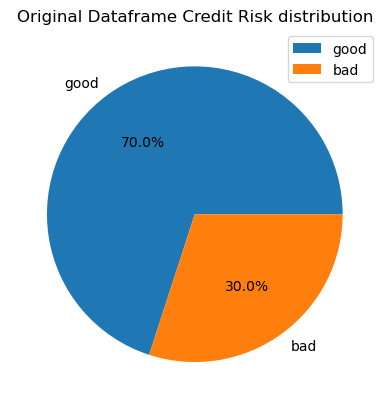

Adverse Impact Ratio:
0.8965673282047968
Standardized Mean Difference:
-0.16166536561821132


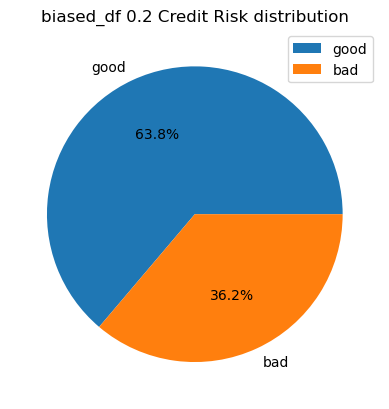

Adverse Impact Ratio:
0.6200142219923719
Standardized Mean Difference:
-0.5809330618586973


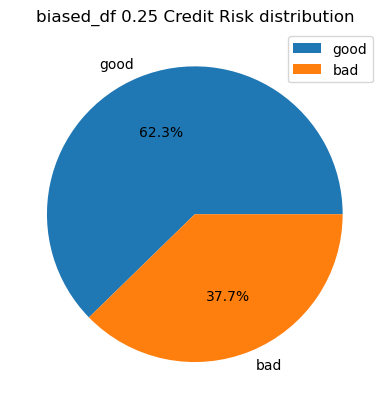

Adverse Impact Ratio:
0.5531062124248498
Standardized Mean Difference:
-0.6888936724510839


In [25]:
plt.pie(df["credit_risk"].value_counts(), labels=['good', 'bad'], autopct='%1.1f%%')
plt.legend()
plt.title("Original Dataframe Credit Risk distribution")
plt.show()

print("Adverse Impact Ratio:")
print(adverse_impact_ratio_for_df(df, 'sex', 0, 'credit_risk'))
print("Standardized Mean Difference:")
print(standardized_mean_difference_for_df(df, 'sex', 0, 1, 'credit_risk'))

plt.pie(biased_df_02["credit_risk"].value_counts(), labels=['good', 'bad'], autopct='%1.1f%%')
plt.legend()
plt.title("biased_df 0.2 Credit Risk distribution")
plt.show()

print("Adverse Impact Ratio:")
print(adverse_impact_ratio_for_df(biased_df_02, 'sex', 0, 'credit_risk'))
print("Standardized Mean Difference:")
print(standardized_mean_difference_for_df(biased_df_02, 'sex', 0, 1, 'credit_risk'))

plt.pie(biased_df_025["credit_risk"].value_counts(), labels=['good', 'bad'], autopct='%1.1f%%')
plt.legend()
plt.title("biased_df 0.25 Credit Risk distribution")
plt.show()

print("Adverse Impact Ratio:")
print(adverse_impact_ratio_for_df(biased_df_025, 'sex', 0, 'credit_risk'))
print("Standardized Mean Difference:")
print(standardized_mean_difference_for_df(biased_df_025, 'sex', 0, 1, 'credit_risk'))

#### Credit Risk percentage for distinct Gender

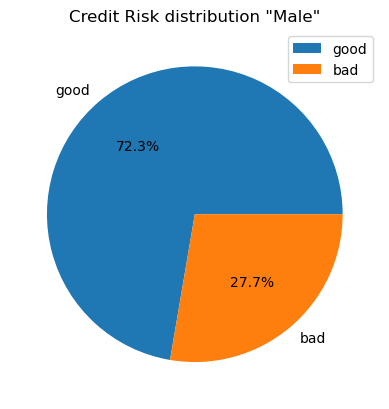

In [26]:


plt.pie(df[df['sex'] == 1]["credit_risk"].value_counts(), labels=['good', 'bad'], autopct='%1.1f%%')
plt.legend()
plt.title("Credit Risk distribution \"Male\"")
plt.show()

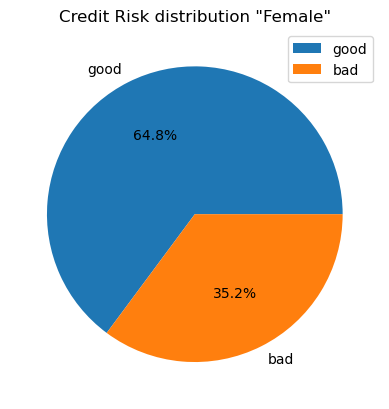

In [27]:


plt.pie(df[df['sex'] == 0]["credit_risk"].value_counts(), labels=['good', 'bad'], autopct='%1.1f%%')
plt.legend()
plt.title("Credit Risk distribution \"Female\"")
plt.show()

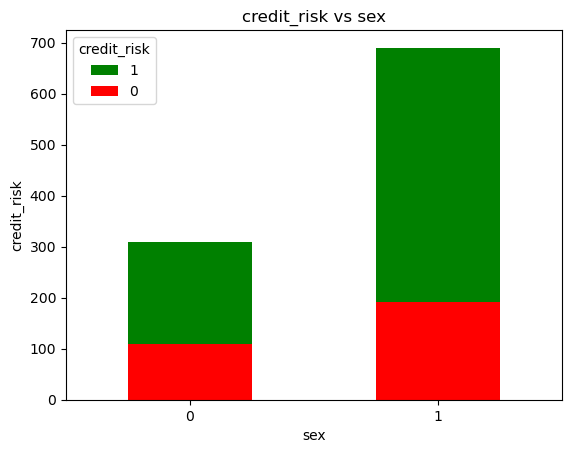

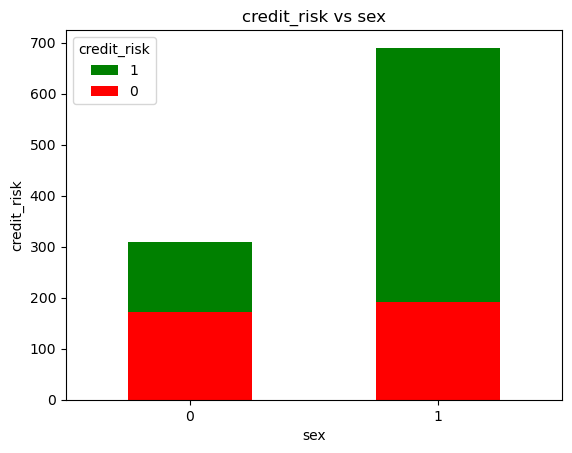

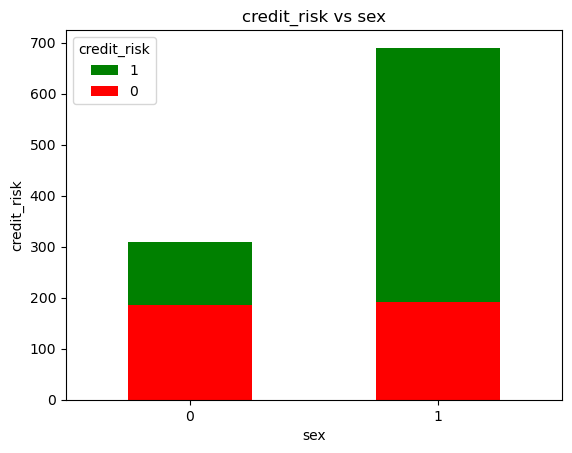

In [28]:
for df in [df, biased_df_02, biased_df_025]:

    grouped = df.groupby(['sex', 'credit_risk']).size().unstack()
    
    colors = {1: 'green', 0: 'red'}

    # Creiamo il grafico a barre stackato
    ax = grouped.plot(kind='bar', stacked=True, color=[colors[col] for col in grouped.columns])

    ax.set_title('credit_risk vs sex')
    ax.set_xlabel('sex')
    ax.set_ylabel('credit_risk')

    # Rotazione delle labels
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

    # Aggiungiamo una legenda
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[::-1], labels[::-1], title='credit_risk')

    plt.show()

checking_account_value


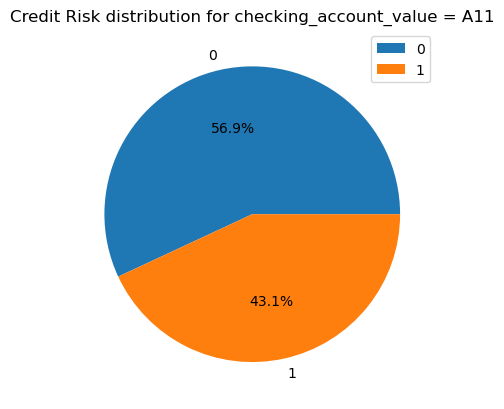

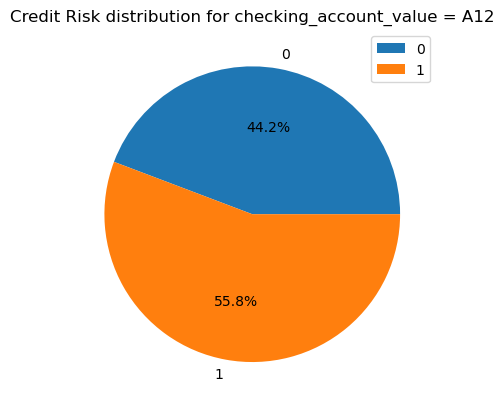

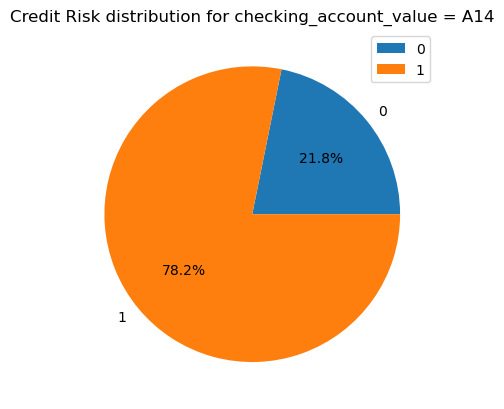

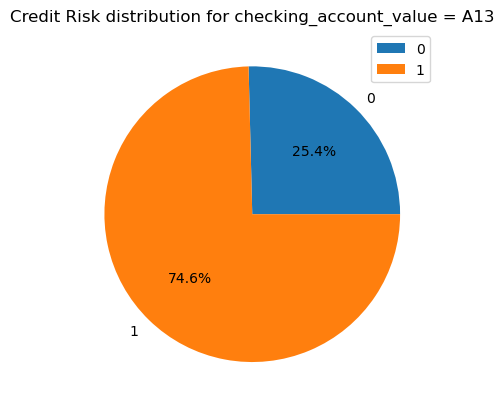

credit_history


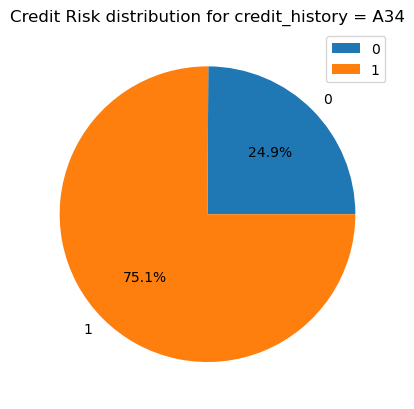

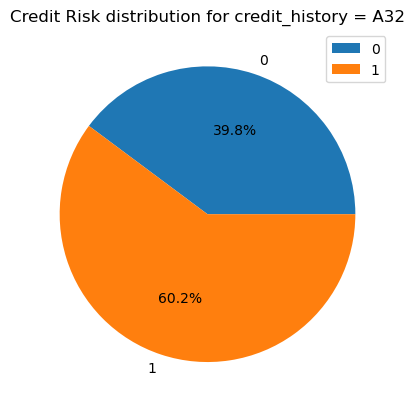

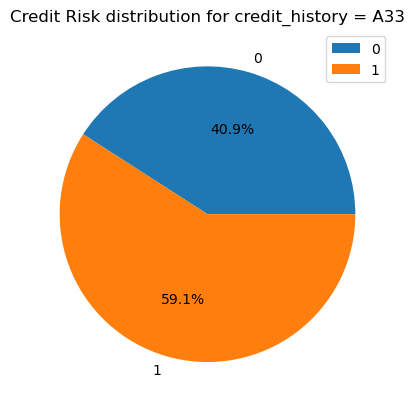

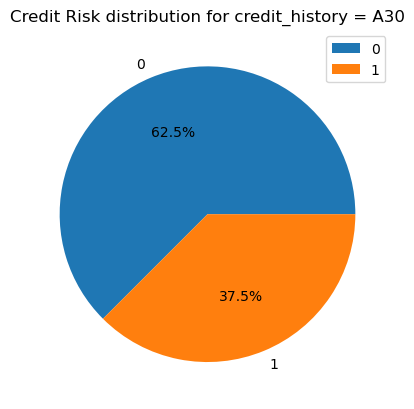

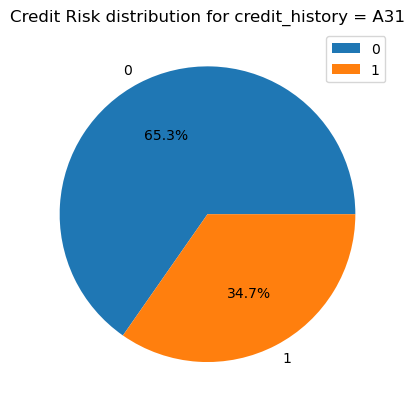

credit_purpose


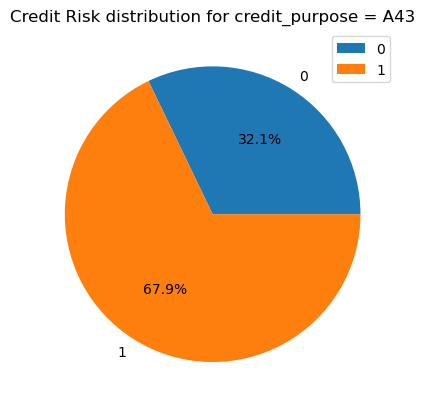

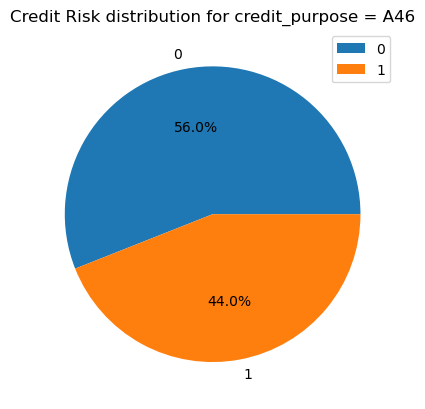

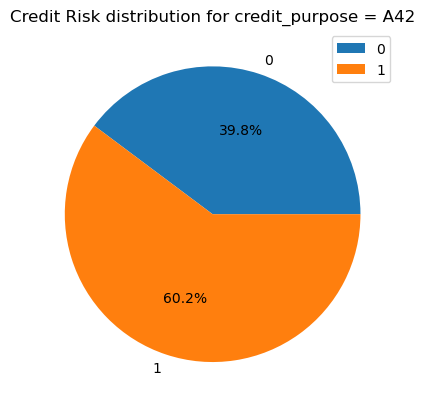

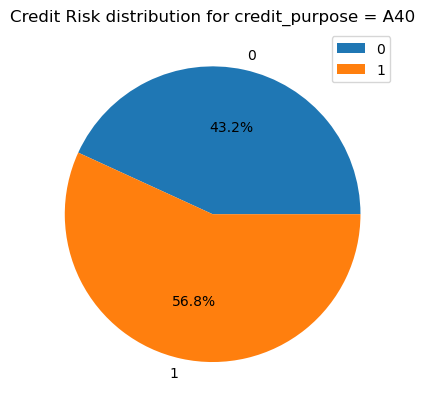

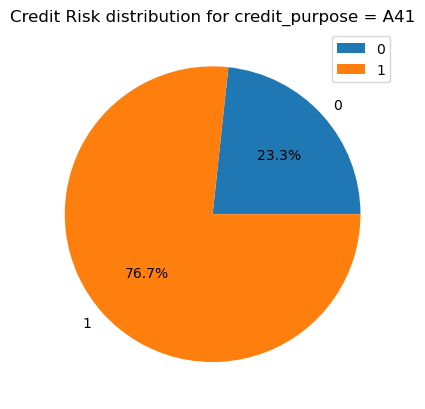

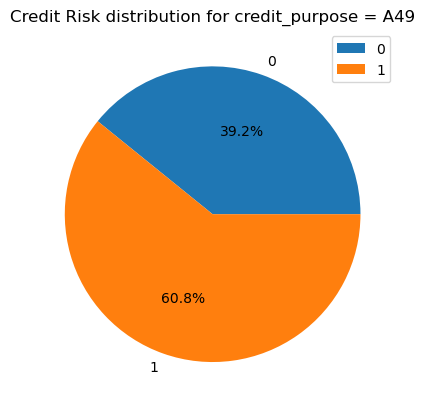

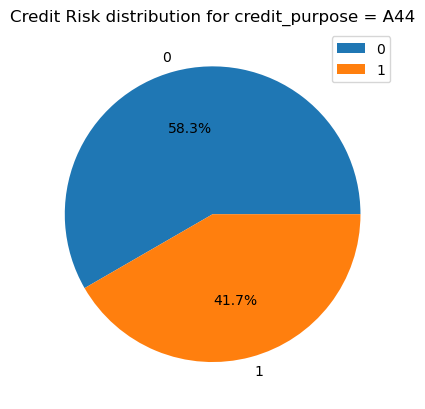

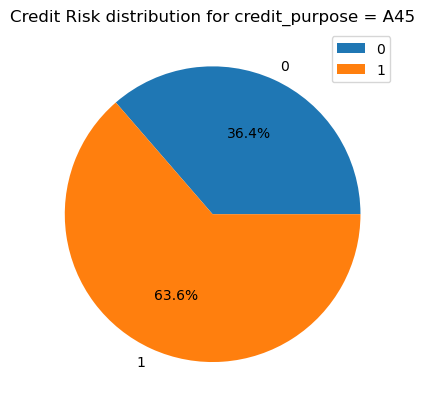

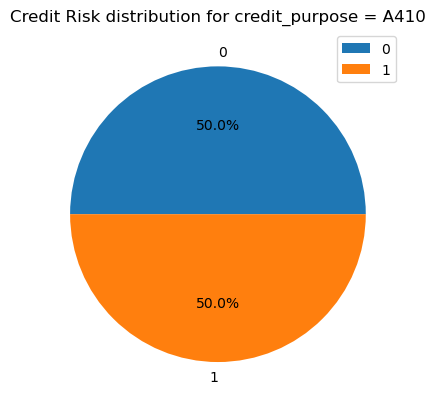

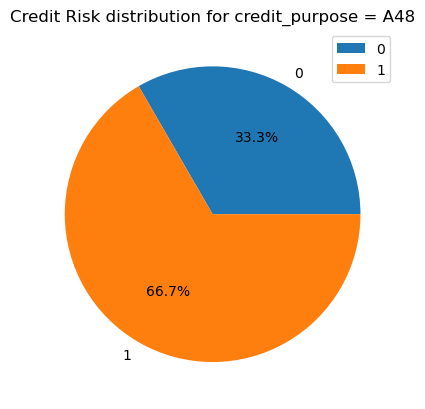

bonds


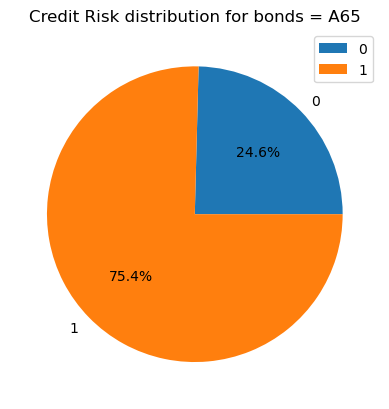

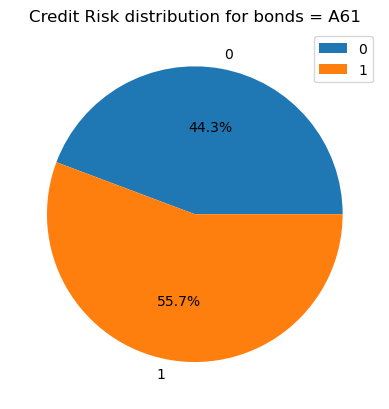

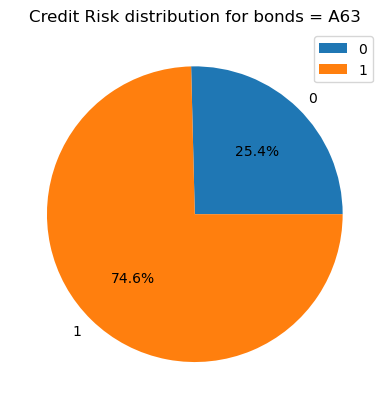

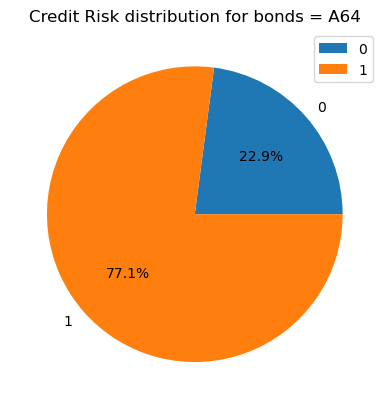

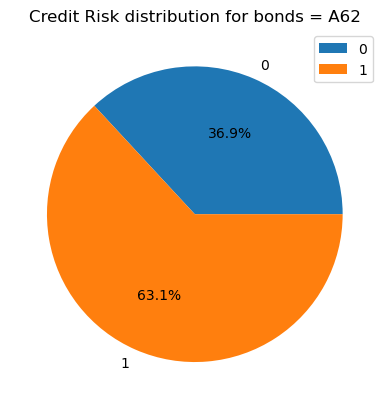

present_employment_since


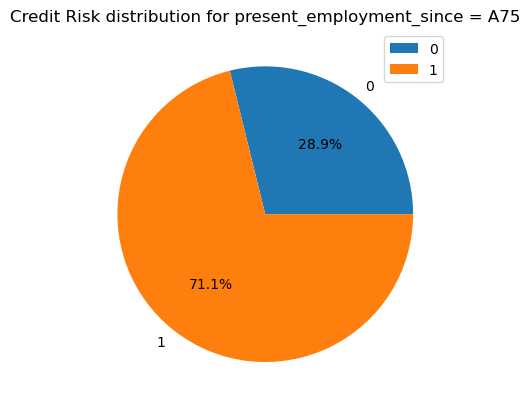

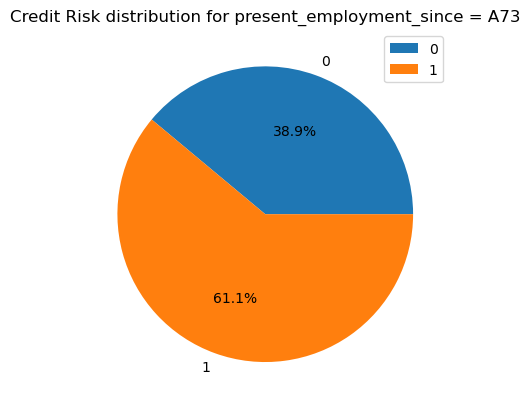

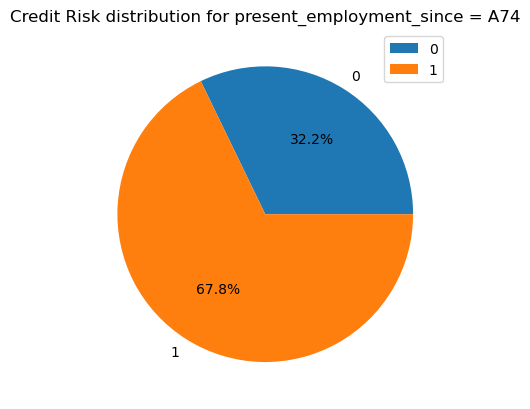

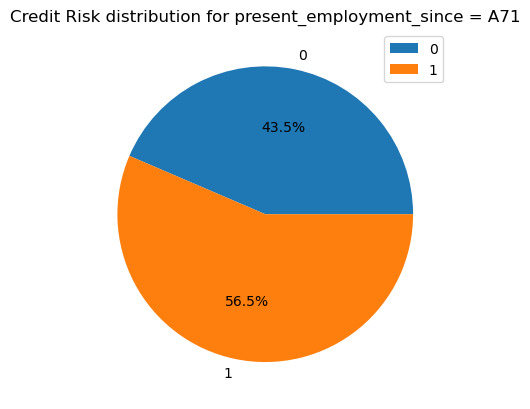

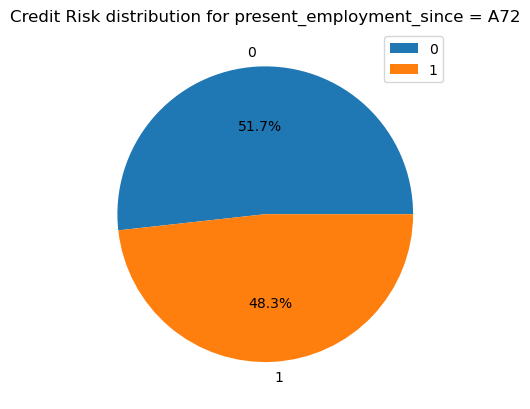

status_and_sex


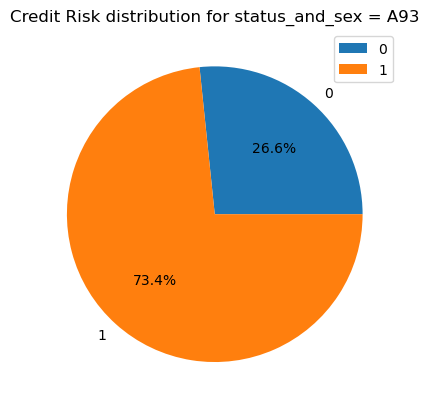

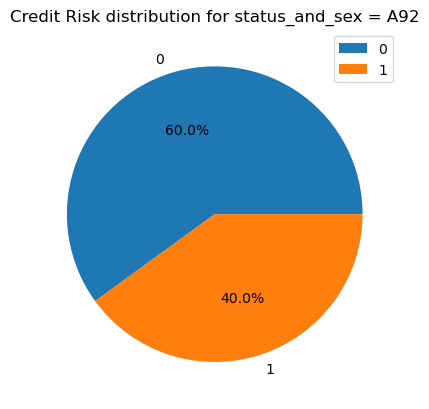

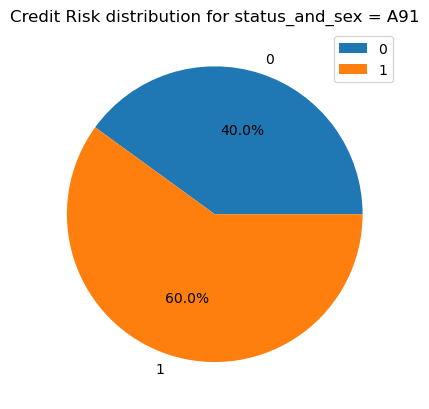

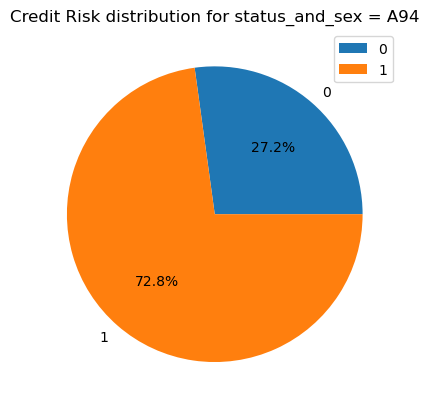

other_debtors


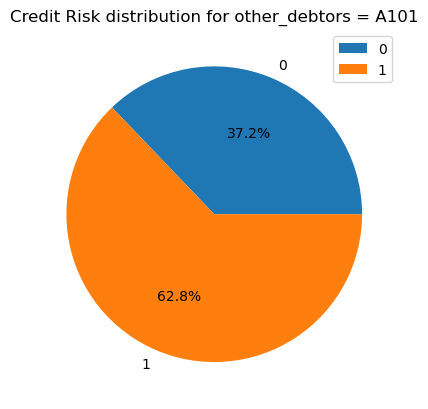

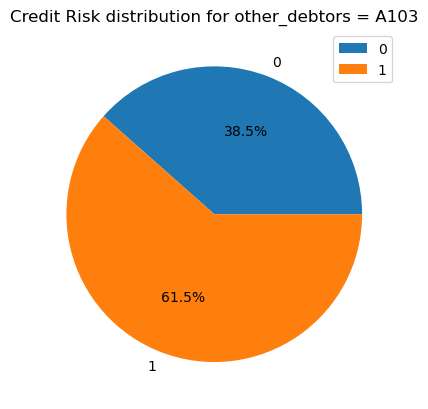

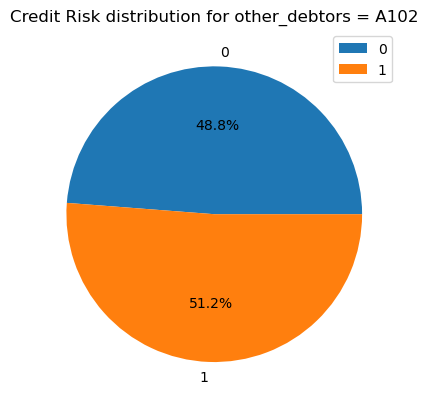

property


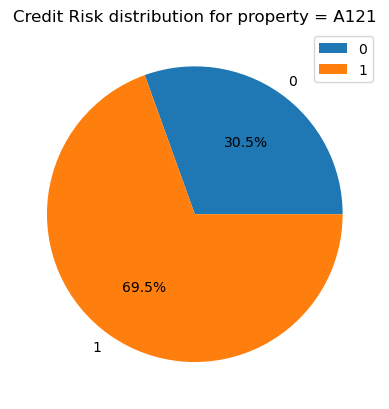

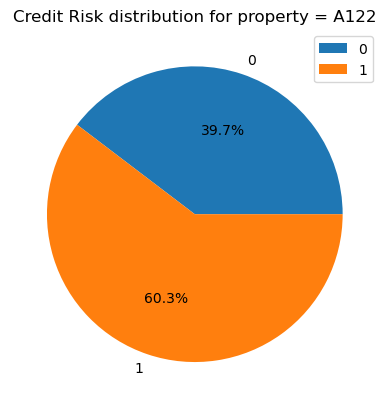

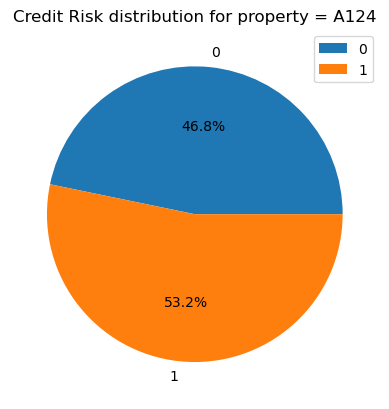

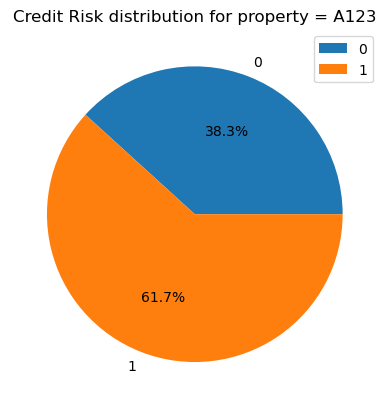

Other_installment_plans


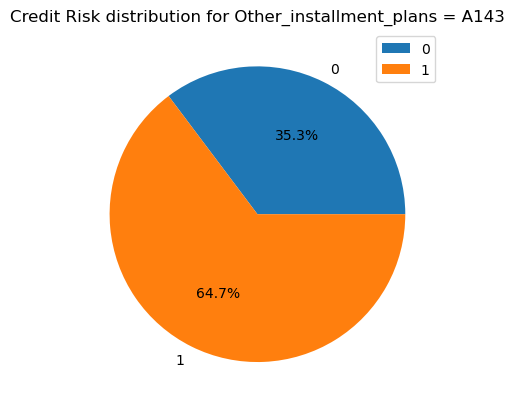

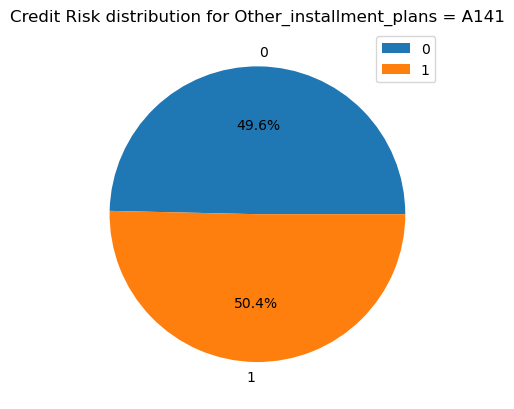

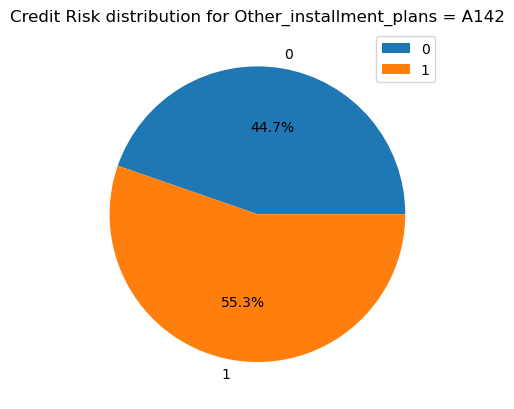

housing


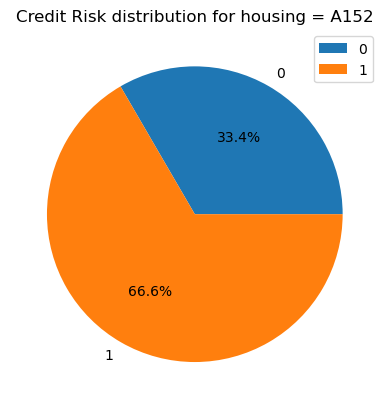

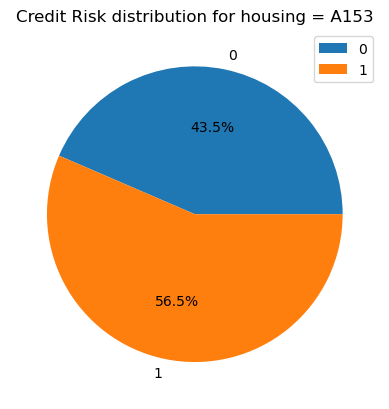

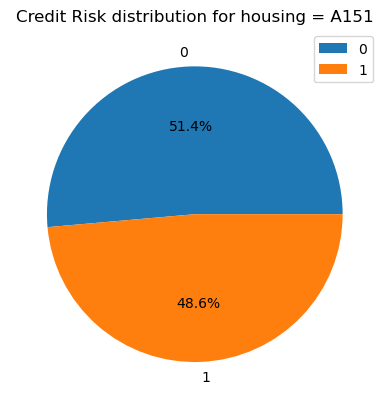

job


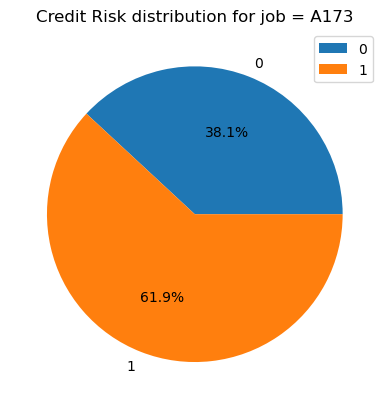

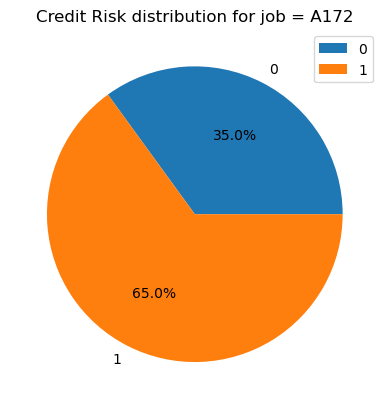

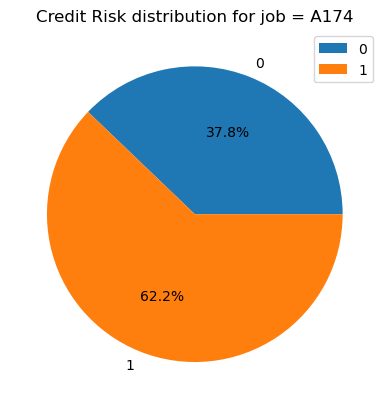

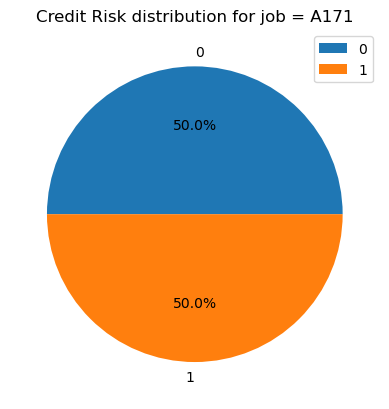

telephone


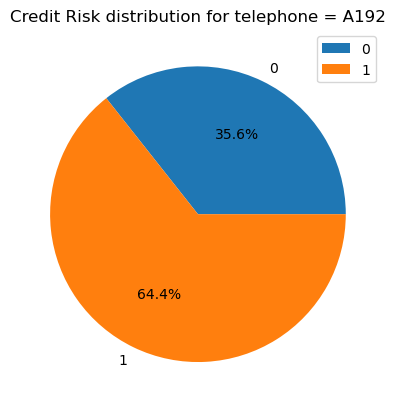

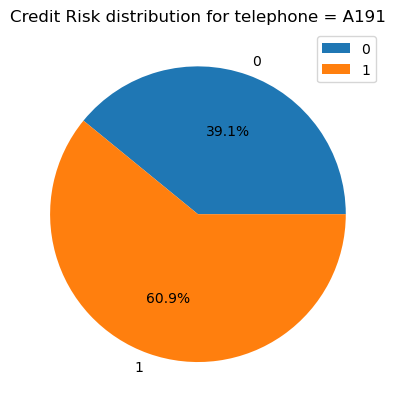

foreign_worker


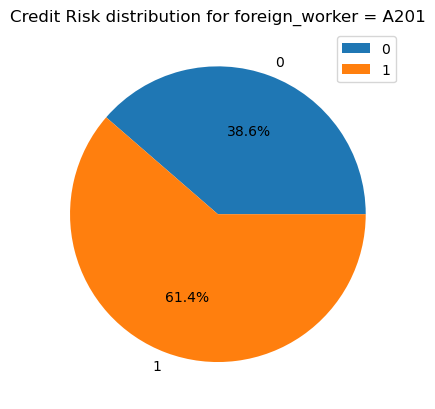

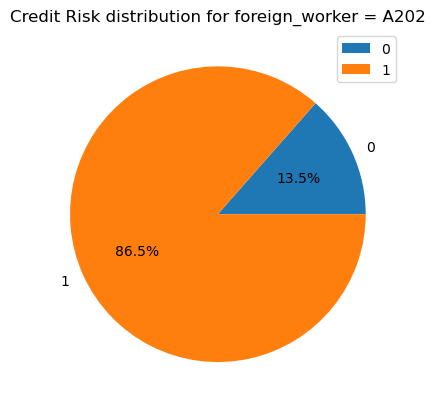

In [29]:
# Cercare anomalie rispetto alle numeriche del dataset

target = "credit_risk"

for col in df.select_dtypes(include=['object']).columns:
    
    print(col)

    for val in df[col].unique():
        
        # Get counts for each target value
        counts = df[df[col] == val][target].value_counts()

        # Sort the counts and labels
        counts = counts.sort_index()
        labels = counts.index

        # Create pie chart
        plt.pie(counts, labels=labels, autopct='%1.1f%%')
        plt.legend()
        plt.title(f"Credit Risk distribution for {col} = {val}")
        plt.show()


### Absolute Frequency

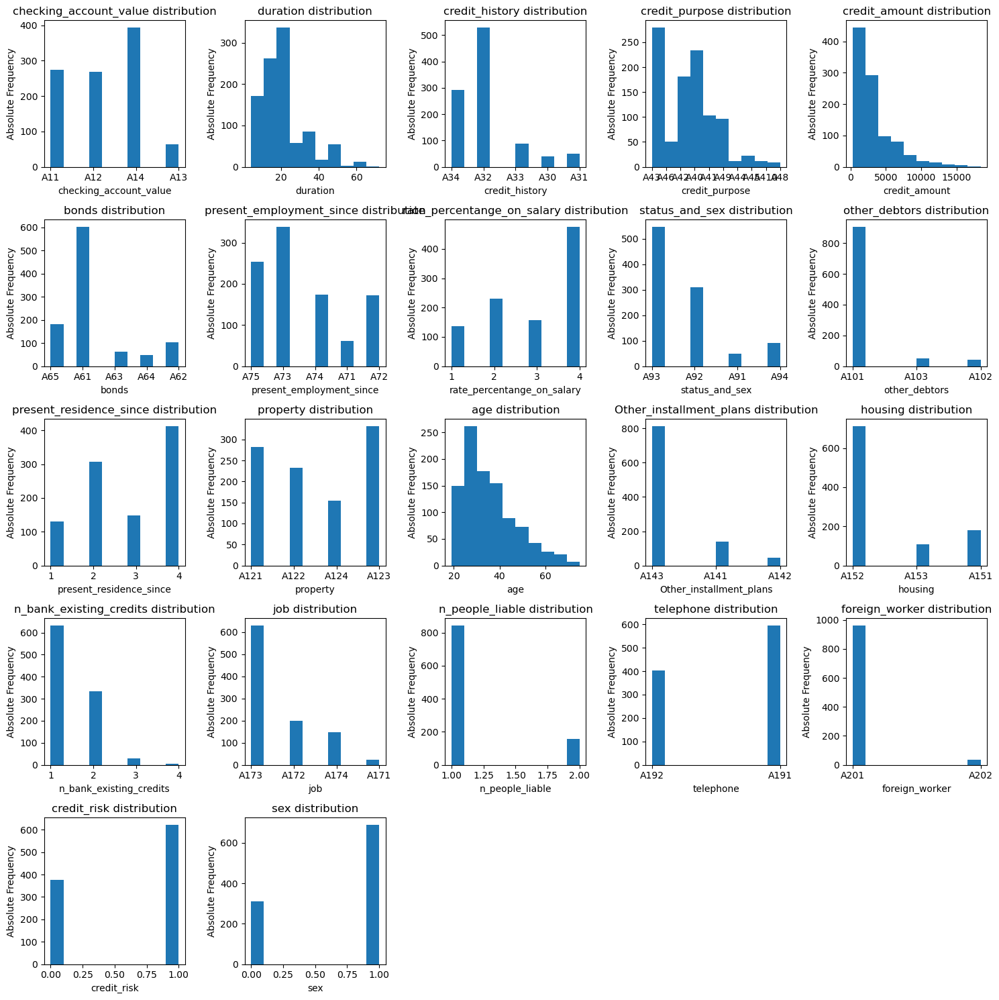

In [30]:
num_features = len(df.columns)
rows = int(np.ceil(np.sqrt(num_features)))
cols = int(np.ceil(num_features / rows))

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(15, 15))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each feature's histogram
for i, col in enumerate(df.columns):
    axes[i].hist(df[col])
    axes[i].set_title(f"{col} distribution")
    axes[i].set_xlabel(col)
    axes[i].set_ylabel("Absolute Frequency")

# Hide empty subplots if there are any
for j in range(num_features, len(axes)):
    axes[j].axis('off')

# Adjust layout to prevent overlapping titles and labels
plt.tight_layout()

# Show the plots
plt.show()


In [31]:
df.corr()

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1134722465.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,duration,credit_amount,rate_percentange_on_salary,present_residence_since,age,n_bank_existing_credits,n_people_liable,credit_risk,sex
duration,1.000000,0.624984,0.074749,0.034067,-0.036136,-0.011284,-0.023834,-0.163762,0.081432
credit_amount,0.624984,1.000000,-0.271316,0.028926,0.032716,0.020795,0.017142,-0.116905,0.093482
rate_percentange_on_salary,0.074749,-0.271316,1.000000,0.049302,0.058266,0.021669,-0.071207,-0.028011,0.086302
present_residence_since,0.034067,0.028926,0.049302,1.000000,0.266419,0.089625,0.042643,0.017891,-0.013818
age,-0.036136,0.032716,0.058266,0.266419,1.000000,0.149254,0.118201,0.126101,0.161694
n_bank_existing_credits,-0.011284,0.020795,0.021669,0.089625,0.149254,1.000000,0.109667,0.065898,0.094260
n_people_liable,-0.023834,0.017142,-0.071207,0.042643,0.118201,0.109667,1.000000,0.053794,0.203431
credit_risk,-0.163762,-0.116905,-0.028011,0.017891,0.126101,0.065898,0.053794,1.000000,0.308423
sex,0.081432,0.093482,0.086302,-0.013818,0.161694,0.094260,0.203431,0.308423,1.000000


### Numerical Correlation

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1584955183.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


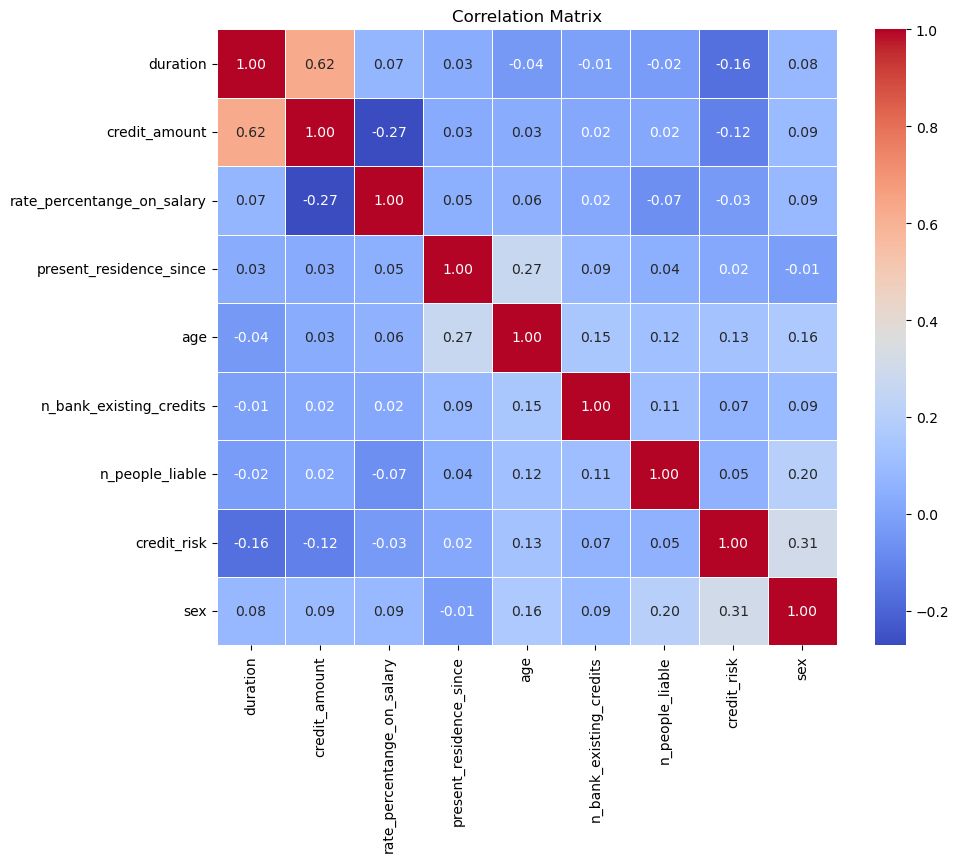

Highly correlated feature pairs:
duration and credit_amount
credit_amount and duration


In [32]:
correlation_matrix = df.corr()


plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()


threshold = 0.6 
highly_correlated = (correlation_matrix.abs() > threshold) & (correlation_matrix.abs() < 1.0)


correlation_pairs = []
for col in highly_correlated.columns:
    correlated_cols = list(highly_correlated.index[highly_correlated[col]])
    if correlated_cols:
        correlation_pairs.append((col, correlated_cols[0]))

print("Highly correlated feature pairs:")
for pair in correlation_pairs:
    print(f"{pair[0]} and {pair[1]}")


### Categorical Correlation

In [33]:
categoricals = list(df.select_dtypes(include=['object']).columns)
categoricals += ['credit_risk', 'sex']
categoricals

['checking_account_value',
 'credit_history',
 'credit_purpose',
 'bonds',
 'present_employment_since',
 'status_and_sex',
 'other_debtors',
 'property',
 'Other_installment_plans',
 'housing',
 'job',
 'telephone',
 'foreign_worker',
 'credit_risk',
 'sex']

In [34]:
from scipy.stats import chi2_contingency

done = []

for col_1 in categoricals:
    for col_2 in categoricals:
        if col_1 != col_2 and col_2 not in done:          

            # Create a contingency table
            contingency_table = pd.crosstab(df[col_1], df[col_2])

            # Perform chi-square test
            chi2, _, _, _ = chi2_contingency(contingency_table)

            # Calculate Cramér's V
            n = df.shape[0]
            cramers_v = (chi2 / n) ** 0.5
            
            done += col_1
            if cramers_v > 0.6:
                print(f'Cramér\'s V fro {col_1} and {col_2}: {cramers_v}')

Cramér's V fro status_and_sex and sex: 1.0
Cramér's V fro property and housing: 0.782315787215184
Cramér's V fro housing and property: 0.7823157872151841
Cramér's V fro sex and status_and_sex: 1.0


### Numerical Scatterplot

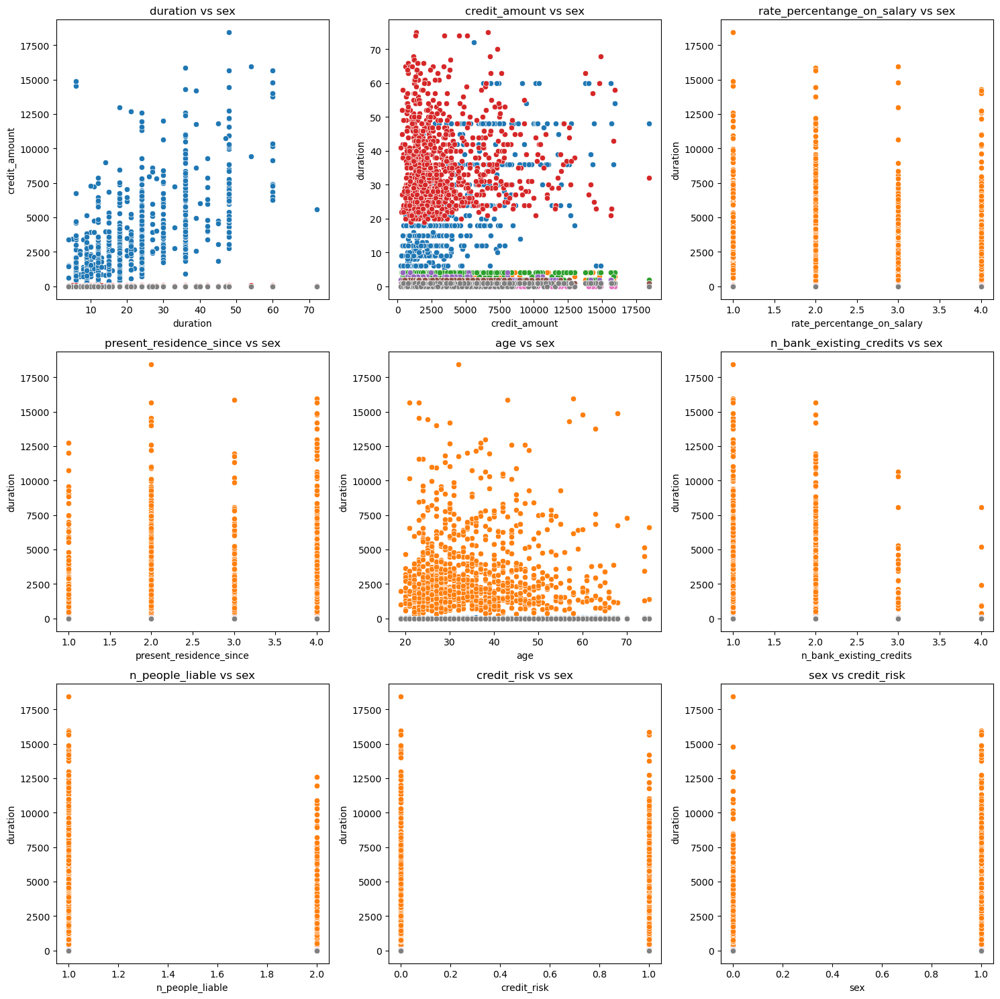

In [35]:
numerical_columns = df.select_dtypes(include=['float64', 'int64'])

# Get the number of numerical featuresm
num_features = len(numerical_columns.columns)

# Calculate the number of rows and columns for the subplot grid
num_rows = int(num_features ** 0.5)
num_cols = (num_features // num_rows) + (num_features % num_rows)

# Create a square grid of subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))

# Flatten the 2D array of subplots into a 1D array
axes = axes.flatten()

# Loop through each numerical column and create a scatterplot
for i, col in enumerate(numerical_columns.columns):
    for j, col_2 in enumerate(numerical_columns.columns):
        if col != col_2:
            sns.scatterplot(x=col, y=col_2, data=numerical_columns, ax=axes[i])
            axes[i].set_title(f"{col} vs {col_2}")

# Adjust layout to prevent overlapping
plt.tight_layout()
plt.show()


# Splitting Dataset

In [36]:

X = df.drop('credit_risk', axis=1)
y = df['credit_risk']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Creating TRAIN_XY

In [37]:
train_XY = X_train.copy()
train_XY['credit_risk'] = y_train

# Correlazione variabili categoriche

In [38]:
import math

target = 'credit_risk'

total_values = train_XY.shape[0]

categoricals = list(train_XY.select_dtypes(include=['object']).columns)
categoricals.append('sex')

IG_dict = {
    'feature': [],
    'information_gain': []
}

entropy = 0

def compute_entropy(df, target):
    entropy = 0
    total_values = df.shape[0]
    
    target_vals = df[target].unique()
    
    for val in target_vals:
        n_val = df[df[target]==val][target].count()
        P_val = n_val/total_values
        if P_val != 0:
            result = -P_val * math.log2(P_val)
            entropy += result
        
    return entropy

total_entropy = compute_entropy(train_XY, 'credit_risk')

for col in categoricals:
    values = train_XY[col].unique()
    total_values = train_XY.shape[0]
    
    remainder = 0
    
    for val in values:     
        isolated_df = train_XY[train_XY[col]==val]
        n_val = isolated_df[target].count()
        P_val = n_val/total_values
        
        conditioned_entropy = compute_entropy(isolated_df, 'credit_risk')
        result = P_val * conditioned_entropy
        remainder += result
        
    IG = total_entropy - remainder
    
    IG_dict['feature'].append(col)
    IG_dict['information_gain'].append(IG)
    
IG_df = pd.DataFrame(IG_dict)

IG_df.sort_values(by='information_gain', ascending=False)


,feature,information_gain
5,status_and_sex,0.075083
13,sex,0.072973
0,checking_account_value,0.067456
1,credit_history,0.036273
2,credit_purpose,0.023348
3,bonds,0.019804
4,present_employment_since,0.018766
9,housing,0.018695
7,property,0.011114
12,foreign_worker,0.009806


# Correlazione Variabili numeriche

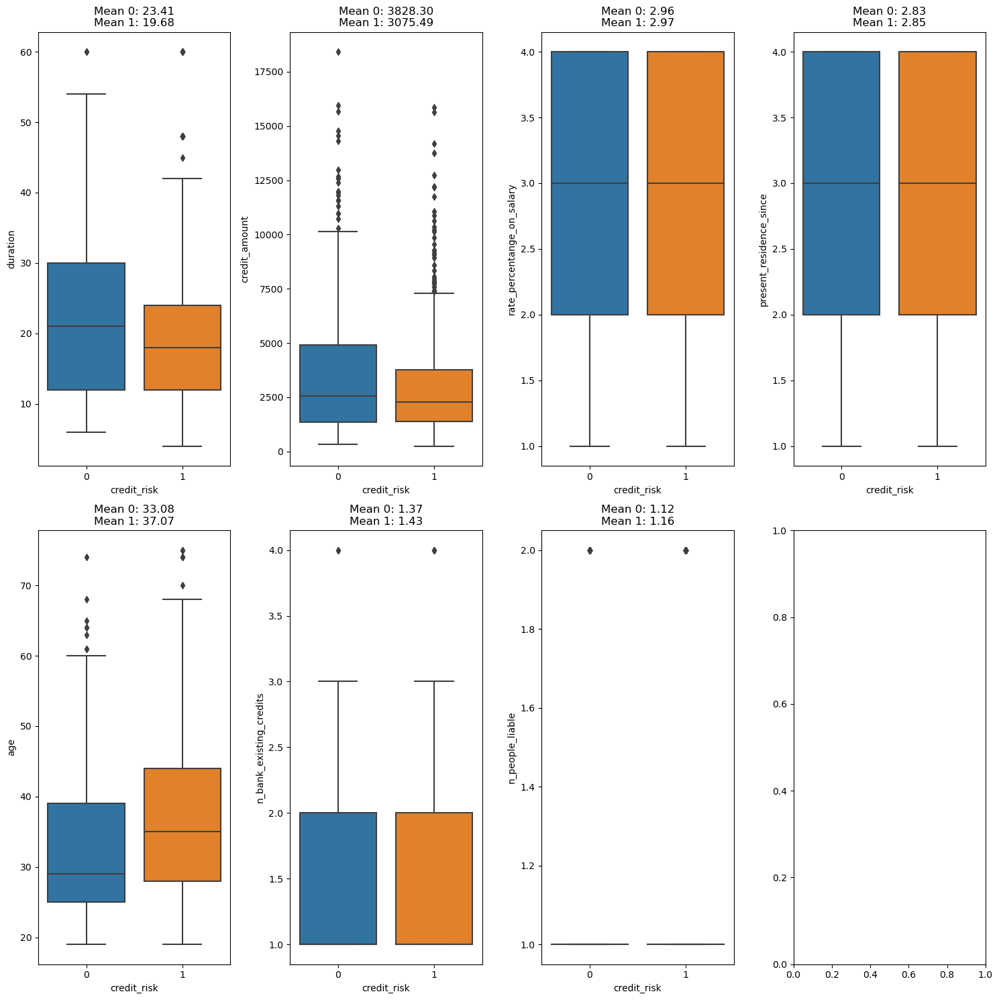

In [39]:
target = "credit_risk"

# Select only integer columns
integer_columns = train_XY.select_dtypes(include=['int64'])

lista = list(integer_columns)
lista.remove("credit_risk")
lista.remove("sex")

num_features = len(lista)


# Calculate the number of rows and columns for the subplot grid
num_rows = int(num_features ** 0.5)
num_cols = (num_features // num_rows) + (num_features % num_rows)

# Create a square grid of subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))

# Flatten the 2D array of subplots into a 1D array
axes = axes.flatten()

# Loop through each integer column and create a boxplot
for i, col in enumerate(lista):
    
    if col != 'credit_risk':
        data_to_plot = {
            '1': train_XY[train_XY[target] == 1][col],
            '0': train_XY[train_XY[target] == 0][col]
        }
        
        mean_0 = train_XY[train_XY[target] == 0][col].mean()
        mean_1 = train_XY[train_XY[target] == 1][col].mean()

        sns.boxplot(x=target, y=col, data=train_XY, ax=axes[i])
        axes[i].set_title(f"Mean 0: {mean_0:.2f}\nMean 1: {mean_1:.2f}")

        
        
# Adjust layout to prevent overlapping
plt.tight_layout()
plt.show()


# Encode Categorical

In [40]:
def encode_all(df):

    def create_foreign_worker_column(x):
        if x == 'A201':  # yes
            return 1
        else:
            return 0    # no

    df['foreign_worker'] = df.foreign_worker.apply(lambda x: create_foreign_worker_column(x))


    def encode_checking_account_value(x):
        if x == 'A14':
            return 0
        return int(x[-1])


    df['checking_account_value'] = df.checking_account_value.apply(lambda x: encode_checking_account_value(x))


    df = pd.get_dummies(df, columns=['credit_history', 
                                     'credit_purpose', 
                                     'status_and_sex', 
                                     'other_debtors', 
                                    'property',
                                    'Other_installment_plans',
                                    'housing',
                                    'job'])


    def encode_tel(x):
        if x =='A191':
            return 0 
        elif x == 'A192':
            return 1
        else:
            raise Exception(f"No option for tel val = {x}")


    df['telephone'] = df.telephone.apply(lambda x: encode_tel(x))



    def encode_bonds(x):
        if x =='A61':
            return 0 
        elif x == 'A62':
            return 100
        elif x == 'A63':
            return 500
        elif x == 'A64':
            return 100
        elif x == 'A65':
            return -1
        else:
            raise Exception(f"No option for val = {x}")


    df['bonds'] = df.bonds.apply(lambda x: encode_bonds(x))



    def encode_present_employment_since(x):
        if x =='A71':
            return -1 
        elif x == 'A72':
            return 0
        elif x == 'A73':
            return 1
        elif x == 'A74':
            return 4
        elif x == 'A75':
            return 7
        else:
            raise Exception(f"No option for val = {x}")


    df['present_employment_since'] = df.present_employment_since.apply(lambda x: encode_present_employment_since(x))
    
    return df
    


In [42]:
X_test.columns

Index(['checking_account_value', 'duration', 'credit_amount', 'bonds',
       'present_employment_since', 'rate_percentange_on_salary',
       'present_residence_since', 'age', 'n_bank_existing_credits',
       'n_people_liable', 'telephone', 'foreign_worker', 'sex',
       'credit_history_A30', 'credit_history_A31', 'credit_history_A32',
       'credit_history_A33', 'credit_history_A34', 'credit_purpose_A40',
       'credit_purpose_A41', 'credit_purpose_A410', 'credit_purpose_A42',
       'credit_purpose_A43', 'credit_purpose_A44', 'credit_purpose_A45',
       'credit_purpose_A46', 'credit_purpose_A48', 'credit_purpose_A49',
       'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93',
       'status_and_sex_A94', 'other_debtors_A101', 'other_debtors_A102',
       'other_debtors_A103', 'property_A121', 'property_A122', 'property_A123',
       'property_A124', 'Other_installment_plans_A141',
       'Other_installment_plans_A142', 'Other_installment_plans_A143',
       'housi

Train dataset has the same proprotion for the label column

In [43]:
# 1 = good
# 2 = bad

y_train.value_counts() / y_train.shape[0] * 100

1    62.125
0    37.875
Name: credit_risk, dtype: float64

In [44]:
X_train_copy = X_train.copy()
X_train_copy['credit_risk'] = y_train

male_count = X_train_copy[X_train_copy['sex']==1]['credit_risk'].count()
female_count = X_train_copy[X_train_copy['sex']==0]['credit_risk'].count()

male_pos_count = X_train_copy[X_train_copy['sex']==1][X_train_copy['credit_risk']==1]['credit_risk'].count()
female_pos_count = X_train_copy[X_train_copy['sex']==0][X_train_copy['credit_risk']==1]['credit_risk'].count()

male_rate = male_pos_count / male_count
female_rate = female_pos_count / female_count

AIR = female_rate / male_rate

AIR

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\713662721.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  male_pos_count = X_train_copy[X_train_copy['sex']==1][X_train_copy['credit_risk']==1]['credit_risk'].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\713662721.py:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  female_pos_count = X_train_copy[X_train_copy['sex']==0][X_train_copy['credit_risk']==1]['credit_risk'].count()


0.5414625438822667

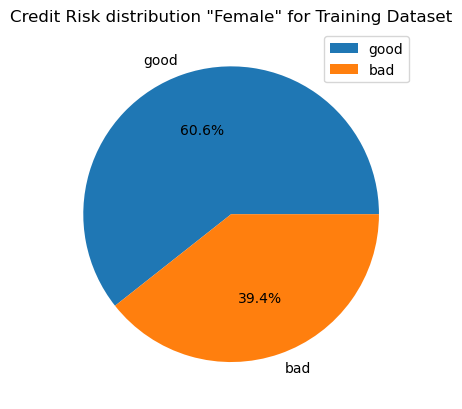

In [45]:

plt.pie(X_train_copy[X_train_copy['sex'] == 0]["credit_risk"].value_counts(), labels=['good', 'bad'], autopct='%1.1f%%')
plt.legend()
plt.title("Credit Risk distribution \"Female\" for Training Dataset")
plt.show()

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1311234482.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  plt.matshow(df.corr(), fignum=f.number)


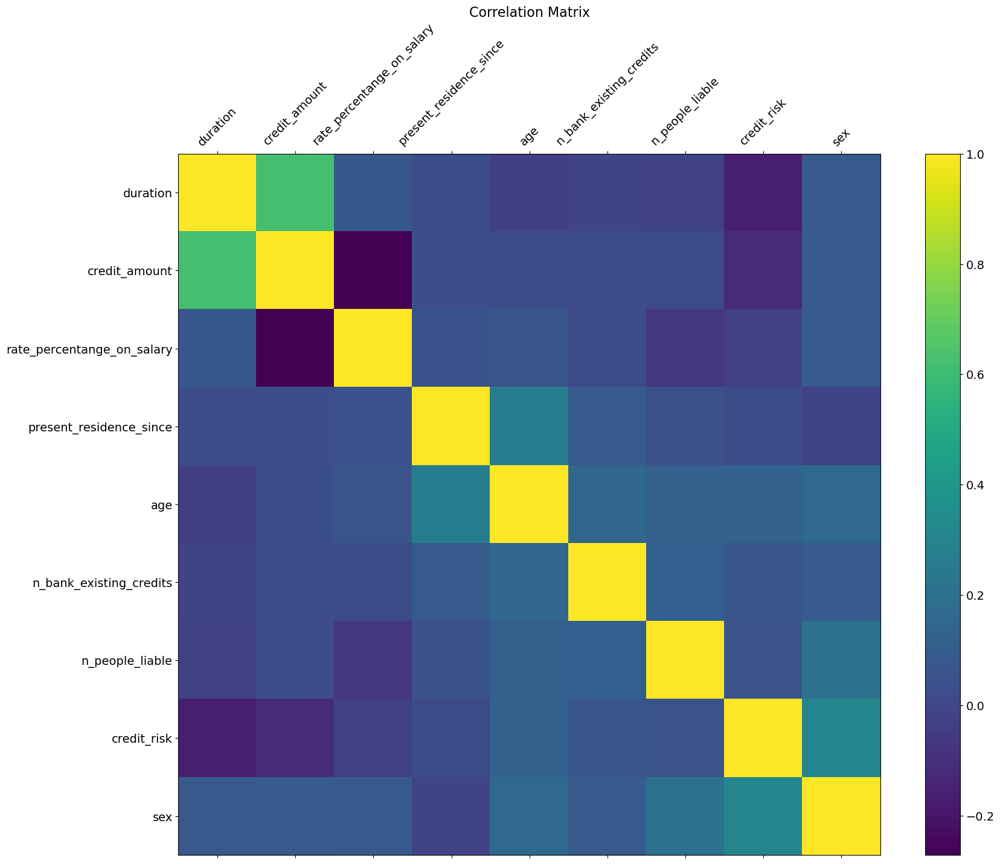

In [46]:
f = plt.figure(figsize=(19, 15))
plt.matshow(df.corr(), fignum=f.number)
plt.xticks(range(df.select_dtypes(['number']).shape[1]), df.select_dtypes(['number']).columns, fontsize=14, rotation=45)
plt.yticks(range(df.select_dtypes(['number']).shape[1]), df.select_dtypes(['number']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [47]:
train_XY = X_train.copy()
train_XY['credit_risk'] = y_train
train_XY.corr()['credit_risk'].sort_values()

status_and_sex_A92             -0.319953
duration                       -0.153136
housing_A151                   -0.135469
checking_account_value         -0.129682
credit_amount                  -0.126078
credit_history_A30             -0.122759
credit_history_A31             -0.116394
foreign_worker                 -0.106636
Other_installment_plans_A141   -0.103032
credit_purpose_A46             -0.097987
property_A124                  -0.088684
credit_purpose_A40             -0.072893
housing_A153                   -0.066622
credit_purpose_A44             -0.062707
credit_purpose_A410            -0.051317
credit_history_A32             -0.046056
property_A123                  -0.027907
job_A171                       -0.027897
job_A173                       -0.025270
Other_installment_plans_A142   -0.021969
credit_history_A33             -0.021041
credit_purpose_A49             -0.017956
other_debtors_A103             -0.017462
other_debtors_A102             -0.014339
property_A122   

# Decision Tree Analysis

Accuracy: 0.64
Confusion Matrix:
[[38 36]
 [36 90]]
Specificity: 0.5135135135135135
Feature Importance:
                         Feature  Importance
2                  credit_amount    0.161391
29            status_and_sex_A92    0.102370
0         checking_account_value    0.097395
7                            age    0.082522
4       present_employment_since    0.064106
1                       duration    0.059530
5     rate_percentange_on_salary    0.049284
3                          bonds    0.031610
27            credit_purpose_A49    0.021246
41  Other_installment_plans_A143    0.020462
6        present_residence_since    0.019453
48                      job_A174    0.019207
10                     telephone    0.017879
36                 property_A122    0.017531
14            credit_history_A31    0.016266
30            status_and_sex_A93    0.015753
18            credit_purpose_A40    0.015436
32            other_debtors_A101    0.014948
13            credit_history_A30    0.013

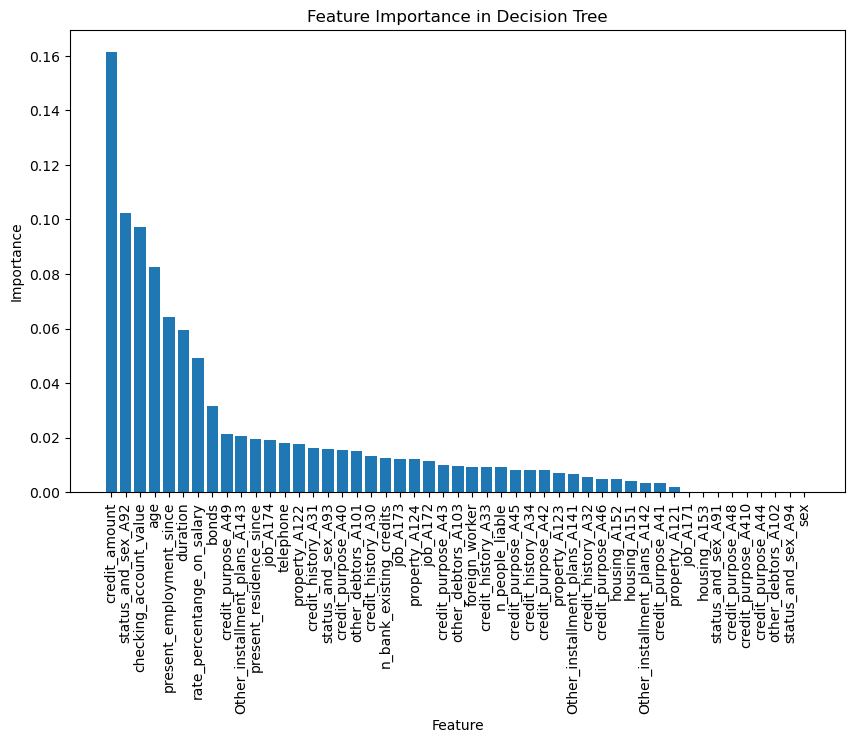

In [48]:
from sklearn.metrics import accuracy_score, confusion_matrix

# Train a Decision Tree classifier
dt_classifier = DecisionTreeClassifier(random_state=42, criterion='gini')
dt_classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = dt_classifier.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix)

# Calculate specificity
specificity = conf_matrix[0, 0] / (conf_matrix[0, 0] + conf_matrix[0, 1])
print("Specificity:", specificity)

# Get feature importances
feature_importances = dt_classifier.feature_importances_

# Create a DataFrame to store feature importances
feature_importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importances})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Display the sorted feature importances
print("Feature Importance:")
print(feature_importance_df)

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.bar(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xticks(rotation=90)
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Feature Importance in Decision Tree')
plt.show()


In [49]:
y_test.value_counts()

1    126
0     74
Name: credit_risk, dtype: int64

In [50]:
pd.Series(y_pred).value_counts()

1    126
0     74
dtype: int64

### Tree Plot

In [51]:

fig, ax = plt.subplots(figsize=(150, 100))
plot_tree(dt_classifier, filled=True, ax=ax)
plt.plot()

[]

### Metrics Collection:

In [52]:
def get_metrics(y_test, y_pred):
    
    conf_matrix = confusion_matrix(y_test, y_pred)
    specificity = conf_matrix[0, 0] / (conf_matrix[0, 0] + conf_matrix[0, 1]) # TN / (total actually neagative)
    
    accuracy = accuracy_score(y_test, y_pred) 
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    
    return specificity, accuracy, precision, recall, f1

    

### Accuracy and Confusion Matix

[[True Negative (TN)  False Positive (FP)]

 [False Negative (FN) True Positive (TP)]]

In [53]:
# predizione del nuovo modello
y_pred = dt_classifier.predict(X_test)

specificity, accuracy, precision, recall, f1 = get_metrics(y_test, y_pred)
cm = confusion_matrix(y_test, y_pred)

print("Confusion matrix:\n", cm)
print(f"\nSpecificity: {specificity}")
print("Accuracy:", cm.diagonal().sum() / cm.sum())
print(f"precision: {precision}")
print(f"recall: {recall}")
print(f"f1: {f1}")

Confusion matrix:
 [[38 36]
 [36 90]]

Specificity: 0.5135135135135135
Accuracy: 0.64
precision: 0.7142857142857143
recall: 0.7142857142857143
f1: 0.7142857142857143


In [54]:
31 / (31+28)

0.5254237288135594

In [55]:
check_test = pd.DataFrame(y_test)

print(check_test[check_test['credit_risk'] == 1].shape)
print(check_test[check_test['credit_risk'] == 2].shape)

(126, 1)
(0, 1)


### DF Concatenation for fairness analysis

In [57]:
def get_final_result_df(y_test, y_pred, X_test):
    results_df = pd.DataFrame({'label': y_test, 'prediction': y_pred})

    # Concatenate the original test data with the results DataFrame
    final_results_df = pd.concat([X_test, results_df], axis=1)

    return final_results_df

### Adverse Impact Ratio

AIR for binary column

In [58]:
def adverse_impacat_ratio(df, marker, val, control_val, target, target_val):
    
    control_pop = df[df[marker]==control_val]
    control_number = control_pop[marker].count()
    control_pos_target = control_pop[df[target]==target_val][marker].count()
    
    control_correct_target = control_pop[df[target]==df['label']][marker].count()
    
    # ratios
    control_pos_rate = control_pos_target / control_number
    control_accuracy = control_correct_target / control_number
    
    
    marker_pop = df[df[marker]==val]
    pop_number = marker_pop[marker].count()
    pop_pos_target = marker_pop[df[target]==target_val][marker].count()

    pop_correct_target = marker_pop[df[target]==df['label']][marker].count()

    #ratios
    pop_pos_rate = pop_pos_target / pop_number
    pop_accuracy = pop_correct_target / pop_number

    AIR_outcome = pop_pos_rate / control_pos_rate
    AIR_accuracy = pop_accuracy / control_accuracy

        
    return AIR_outcome, AIR_accuracy

### Standardized Mean Difference

In [59]:
def standardized_mean_difference(df, marker, val, control_val, target):
    
    # small 0.2, 0.5, and 0.8 large
    
    control_values = df[df[marker] == control_val][target].values
    control_mean = np.mean(control_values)
    control_std = np.std(control_values)


    pop_values = df[df[marker] == val][target].values
    pop_mean = np.mean(pop_values)
    pop_std = np.std(pop_values)

    smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)

    return smd


In [60]:
pd.Series(y_train).value_counts()
#y_test.unique()

print(pd.Series(y_test).value_counts()[0] / pd.Series(y_test).value_counts()[1]*100)
print(pd.Series(y_train).value_counts()[0] / pd.Series(y_train).value_counts()[1]*100)

58.730158730158735
60.96579476861167


### Model Hyperparameter Tuning

In [229]:
df = encode_all(df)

X = df.drop('credit_risk', axis=1)
y = df['credit_risk']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Compute Confidence Interval

In [81]:
from sklearn.model_selection import cross_val_score, cross_val_predict, KFold, StratifiedKFold 
import scipy.stats as st

def get_confindence_interval(metric_list, alpha=0.90):
    return st.t.interval(alpha=alpha, 
                  df=len(metric_list)-1, 
                  loc=np.mean(metric_list), 
                  scale=st.sem(metric_list))

In [230]:

result = {
    "columns_removed": [],
    "class_weight": [],
    "max_depth" : [],
    "criterion" : [],
    "ccp_alpha" : [],
    "accuracy" : [],
    "specificity" : [],
    "precision" : [],
    "recall" : [],
    "f1" : [],
    "smd" : [],
    "air_outcome" : [],
    "air_out_accuracy" : [],
    "accuracy_confidence" : [],
    "specificity_confidence" : [],
    "precision_confidence" : [],
    "recall_confidence" : [],
    "f1_confidence" : [],
    "smd_confidence" : [],
    "air_outcome_confidence" : [],
    "air_out_accuracy_confidence" : []
}

class_weight_list = [None, "balanced"]
max_depth_list = [2, 3, 5, 7, 10, 50, None] 
criterion_list = ['gini', 'entropy']
ccp_alpha_list = [0.0, 0.01, 0.05, 0.2, 0.25, 0.3]  
columns_removed = [None, ['sex'], ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'],
                  ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94']]

skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

for column_removed in columns_removed:
    X_train_copy = X_train.copy()
        
    if column_removed != None:
        
        X_train_copy = X_train_copy.drop(columns=column_removed)       
            
    for class_weight in class_weight_list:
        for max_depth_val in max_depth_list:
            for criterion_val in criterion_list:
                for ccp_alpha_val in ccp_alpha_list:
                    clf = DecisionTreeClassifier(class_weight=class_weight, 
                                             max_depth=max_depth_val, 
                                             ccp_alpha=ccp_alpha_val, 
                                             criterion=criterion_val)
                    
                    validation_accuracies = []
                    validation_specificities = []
                    validation_precisions = []
                    validation_recalls = []
                    validation_f1s = []
                    
                    validation_smds = []
                    validation_air_outcomes = []
                    validation_air_accuracies = []
                    
                    for train_index, val_index in skf.split(X_train_copy, y_train):
                        X_train_fold, X_val_fold = X_train_copy.iloc[train_index], X_train_copy.iloc[val_index]
                        y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

                        clf.fit(X_train_fold, y_train_fold)

                        y_pred_val = clf.predict(X_val_fold)
                        
                        # get original with sex column
                        X_val_fold_original = X_train.iloc[val_index]
                        
                        # Performance Metrics
                        specificity, accuracy, precision, recall, f1 = get_metrics(y_val_fold, y_pred_val)
                        
                        # Fairness Metrics
                        conc_result_df = get_final_result_df(y_val_fold, y_pred_val, X_val_fold_original)                        
                        smd = standardized_mean_difference(conc_result_df, 'sex', 0, 1, 'prediction')
                        air_outcome, air_out_accuracy = adverse_impacat_ratio(conc_result_df, 'sex', 0, 1, 'prediction', 1)
                        
                        
                        validation_accuracies.append(accuracy)
                        validation_specificities.append(specificity)
                        validation_precisions.append(precision)
                        validation_recalls.append(recall)
                        validation_f1s.append(f1)
                        validation_smds.append(smd)
                        validation_air_outcomes.append(air_outcome)
                        validation_air_accuracies.append(air_out_accuracy)
                        
                    
                    val_acc_mean = np.mean(validation_accuracies)
                    val_spec_mean = np.mean(validation_specificities)
                    val_prec_mean = np.mean(validation_precisions)
                    val_rec_mean = np.mean(validation_recalls)
                    val_f1_mean = np.mean(validation_f1s)
                    val_smd_mean = np.mean(validation_smds)
                    val_air_mean = np.mean(validation_air_outcomes)
                    val_air_acc_mean = np.mean(validation_air_accuracies)
                        
                    
                    # Hyperparameters
                    if column_removed != None: 
                        result["columns_removed"].append(', '.join(column_removed))
                    else:
                        result["columns_removed"].append("None")
                    result["class_weight"].append(class_weight)
                    result["max_depth"].append(max_depth_val)
                    result["criterion"].append(criterion_val)
                    result["ccp_alpha"].append(ccp_alpha_val)
                    
                    result["accuracy_confidence"].append(get_confindence_interval(validation_accuracies))
                    result["accuracy"].append(val_acc_mean)
                    result["specificity_confidence"].append(get_confindence_interval(validation_specificities))
                    result["specificity"].append(val_spec_mean)
                    result["precision_confidence"].append(get_confindence_interval(validation_precisions))
                    result["precision"].append(val_prec_mean)
                    result["recall_confidence"].append(get_confindence_interval(validation_recalls))
                    result["recall"].append(val_rec_mean)
                    result["f1_confidence"].append(get_confindence_interval(validation_f1s))
                    result["f1"].append(val_f1_mean)
                    result["smd_confidence"].append(get_confindence_interval(validation_smds))
                    result["smd"].append(val_smd_mean)
                    result["air_outcome_confidence"].append(get_confindence_interval(validation_air_outcomes))
                    result["air_outcome"].append(val_air_mean)
                    result["air_out_accuracy_confidence"].append(get_confindence_interval(validation_air_accuracies))
                    result["air_out_accuracy"].append(val_air_acc_mean)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2351: RuntimeWarning: invalid value encountered in multiply
  lower_bound = _a * scale + loc
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sci

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2351: RuntimeWarning: invalid value encountered in multiply
  lower_bound = _a * scale + loc
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sci

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Lo

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\T

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

In [231]:
df_kpi = pd.DataFrame(result)
df_kpi.describe()

,max_depth,ccp_alpha,accuracy,specificity,precision,recall,f1,smd,air_outcome,air_out_accuracy
count,576.000000,672.000000,672.000000,672.000000,672.000000,672.000000,672.000000,224.000000,672.000000,672.000000
mean,12.833333,0.135000,0.677405,0.249198,0.746014,0.862038,0.777726,-0.128544,0.964743,0.915176
std,16.841357,0.119637,0.040516,0.321553,0.064242,0.190865,0.072179,0.053533,0.052159,0.042610
min,2.000000,0.000000,0.575000,0.000000,0.698750,0.465162,0.602681,-0.281690,0.799566,0.880534
25%,3.000000,0.010000,0.680937,0.000000,0.698750,0.762143,0.768991,-0.152640,0.918619,0.885598
50%,6.000000,0.125000,0.698750,0.000000,0.698750,1.000000,0.822658,-0.116845,1.000000,0.885598
75%,10.000000,0.250000,0.698750,0.484667,0.778761,1.000000,0.822658,-0.113860,1.000000,0.943693
max,50.000000,0.300000,0.723750,0.859333,0.886664,1.000000,0.822658,-0.012046,1.000000,1.023614


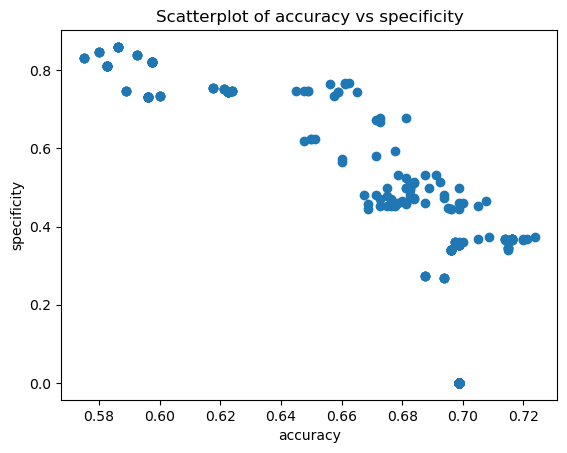

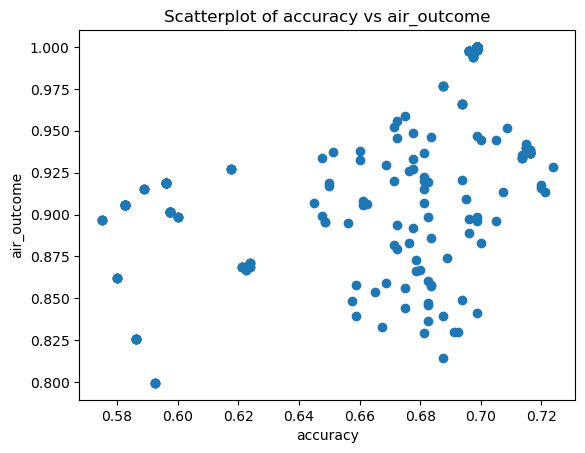

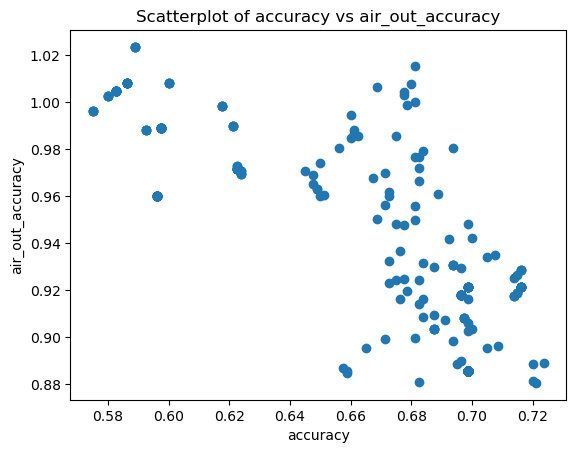

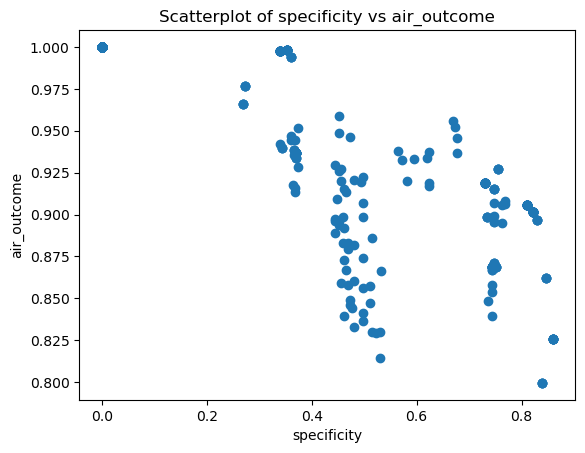

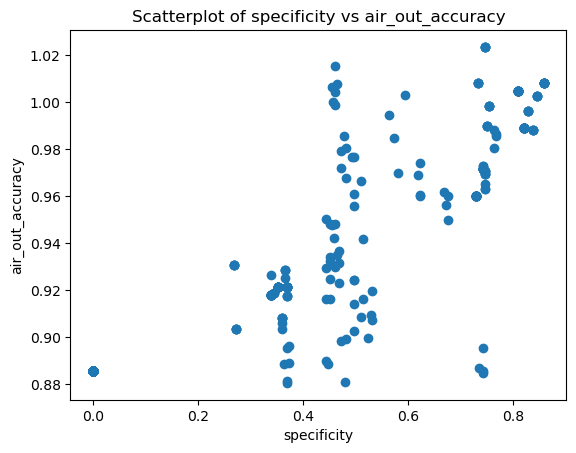

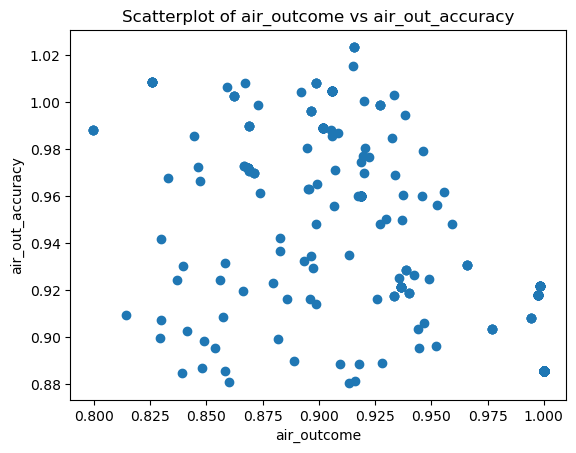

In [232]:
kpis = ['accuracy', 'specificity', 'air_outcome', 'air_out_accuracy']

done_1 = []

for col in kpis:
    
    for col_2 in kpis:
        if col !=  col_2 and col_2 not in done_1:
            plt.scatter(df_kpi[col], df_kpi[col_2] )
            plt.title(f'Scatterplot of {col} vs {col_2}')
            plt.xlabel(col)
            plt.ylabel(col_2)
            plt.show()
            
            done_1.append(col)

### Navigating KPI DataFrame

In [233]:
df_kpi[df_kpi['specificity'] >= 0.65]\
    [df_kpi['accuracy'] >= 0.68]\
    [df_kpi['air_outcome'] >= 0.8]\
    [df_kpi['air_out_accuracy'] >= 0.8]

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\2628464136.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_kpi[df_kpi['specificity'] >= 0.65]\


,columns_removed,class_weight,max_depth,criterion,ccp_alpha,accuracy,specificity,precision,recall,f1,...,air_outcome,air_out_accuracy,accuracy_confidence,specificity_confidence,precision_confidence,recall_confidence,f1_confidence,smd_confidence,air_outcome_confidence,air_out_accuracy_confidence
120,None,balanced,7.0,gini,0.0,0.68125,0.676667,0.832039,0.683279,0.748879,...,0.937008,0.949769,"(0.6477385402039509, 0.7147614597960491)","(0.6093137967781928, 0.7440195365551407)","(0.7995313564804964, 0.8645472388583701)","(0.6471080591871359, 0.7194503823713057)","(0.7195048450839656, 0.7782523628374423)","(-0.22892356412171339, 0.039847089910595976)","(0.832574259945108, 1.0414409187368874)","(0.8627552458784874, 1.0367829360880263)"


### TEST

In [235]:
clf = DecisionTreeClassifier(class_weight='balanced', 
                                             max_depth=7, 
                                             ccp_alpha=0.0, 
                                             criterion='gini')

clf.fit(X_train, y_train)

predictions = clf.predict(X_test)

# Performance Metrics
specificity, accuracy, precision, recall, f1 = get_metrics(y_test, predictions)

# Fairness Metrics
conc_result_df = get_final_result_df(y_test, predictions, X_test)                        
smd = standardized_mean_difference(conc_result_df, 'sex', 0, 1, 'prediction')
air_outcome, air_out_accuracy = adverse_impacat_ratio(conc_result_df, 'sex', 0, 1, 'prediction', 1)

print(f"specificity: {specificity}")
print(f"accuracy: {accuracy}")
print(f"precision: {precision}")
print(f"recall: {recall}")
print(f"f1: {f1}")
print(f"smd: {smd}")
print(f"air_outcome: {air_outcome}")
print(f"air_out_accuracy: {air_out_accuracy}")
print(f"confusion matrix: \n{confusion_matrix(y_test, predictions)}")

specificity: 0.6779661016949152
accuracy: 0.72
precision: 0.8455284552845529
recall: 0.7375886524822695
f1: 0.7878787878787878
smd: 0.02858893736394383
air_outcome: 1.0227272727272727
air_out_accuracy: 1.0588235294117647
confusion matrix: 
[[ 40  19]
 [ 37 104]]


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


In [180]:
df_kpi['class_weight'] = df_kpi.class_weight.apply(lambda x: 'None' if x == None else x)

In [334]:
df_kpi.groupby('max_depth')['smd'].mean()

max_depth
2.0    -0.094226
3.0    -0.086477
5.0    -0.123591
7.0    -0.134934
10.0   -0.139434
50.0   -0.152136
Name: smd, dtype: float64

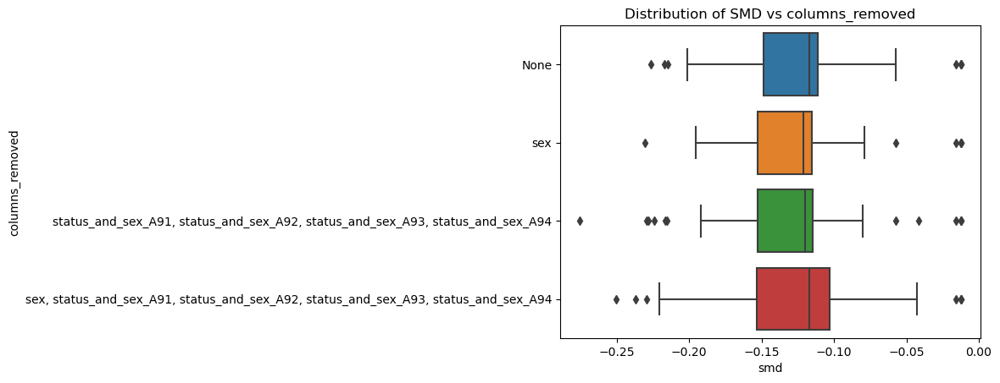

In [181]:
sns.boxplot(x='smd', y='columns_removed', data=df_kpi)
plt.title(f'Distribution of SMD vs columns_removed')
plt.show()

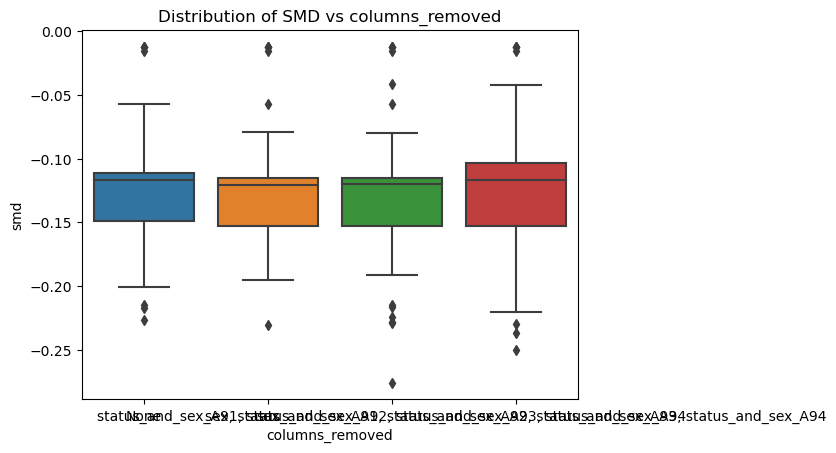

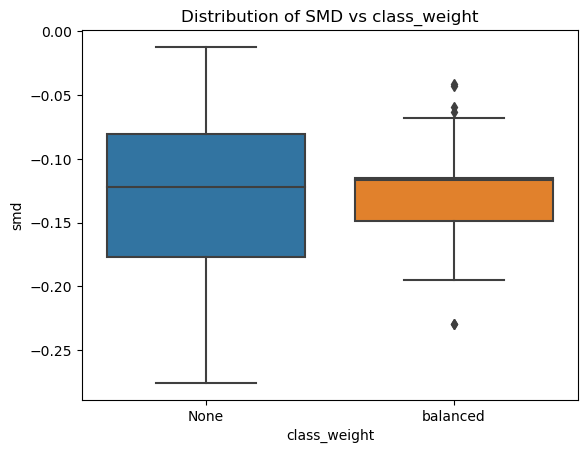

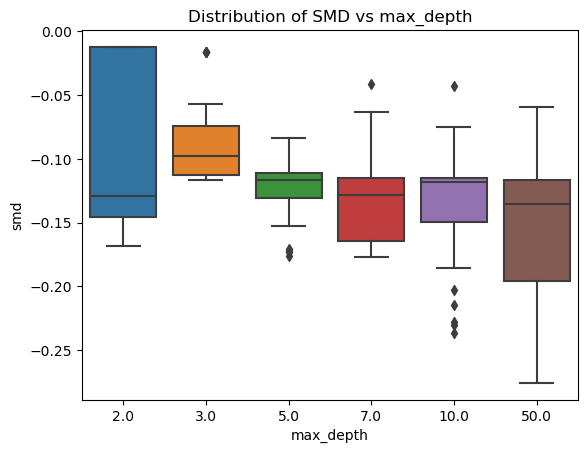

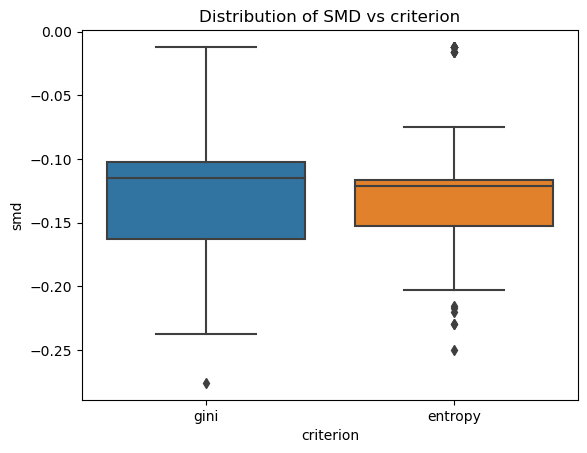

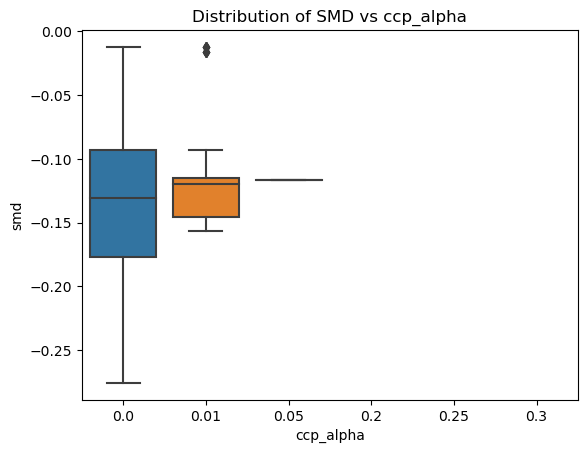

In [182]:
for param in ['columns_removed', 'class_weight', 'max_depth', 'criterion', 'ccp_alpha' ]:

    sns.boxplot(x=param, y='smd', data=df_kpi)
    plt.title(f'Distribution of SMD vs {param}')
    plt.show()

In [336]:
df_kpi.corr()

,max_depth,ccp_alpha,accuracy,specificity,precision,recall,f1,smd,air_outcome,air_out_accuracy
max_depth,1.000000e+00,-1.993012e-17,0.039133,-0.018143,-0.034019,0.025084,0.039280,-0.318495,-0.037528,0.007056
ccp_alpha,-1.993012e-17,1.000000e+00,0.492179,-0.766287,-0.721642,0.705696,0.593958,0.109784,0.683585,-0.688556
accuracy,3.913320e-02,4.921794e-01,1.000000,-0.864618,-0.901102,0.931082,0.985652,0.040267,0.743107,-0.863996
specificity,-1.814290e-02,-7.662872e-01,-0.864618,1.000000,0.992931,-0.988322,-0.934425,-0.128553,-0.888664,0.930215
precision,-3.401929e-02,-7.216418e-01,-0.901102,0.992931,1.000000,-0.994241,-0.960227,-0.088976,-0.881377,0.926626
recall,2.508377e-02,7.056958e-01,0.931082,-0.988322,-0.994241,1.000000,0.977417,0.090003,0.870566,-0.937441
f1,3.928048e-02,5.939576e-01,0.985652,-0.934425,-0.960227,0.977417,1.000000,0.048498,0.812474,-0.908452
smd,-3.184948e-01,1.097842e-01,0.040267,-0.128553,-0.088976,0.090003,0.048498,1.000000,0.821890,0.032260
air_outcome,-3.752809e-02,6.835851e-01,0.743107,-0.888664,-0.881377,0.870566,0.812474,0.821890,1.000000,-0.808191
air_out_accuracy,7.056151e-03,-6.885564e-01,-0.863996,0.930215,0.926626,-0.937441,-0.908452,0.032260,-0.808191,1.000000


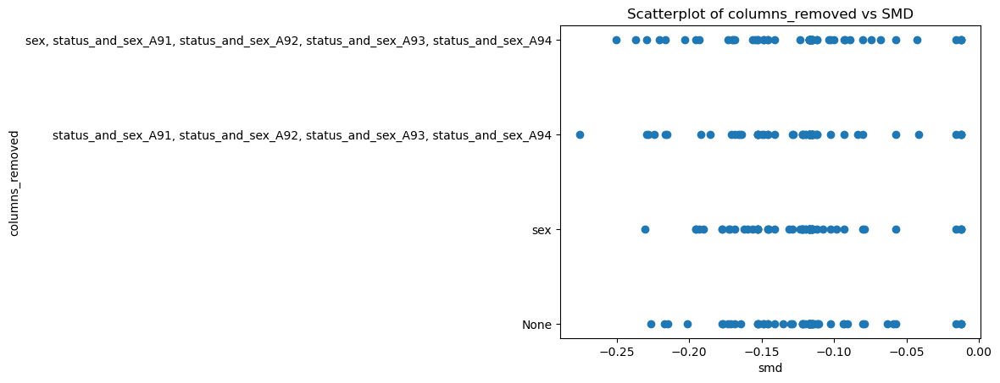

In [184]:
plt.scatter(df_kpi["smd"], df_kpi["columns_removed"])
plt.title(f'Scatterplot of {"columns_removed"} vs SMD')
plt.xlabel("smd")
plt.ylabel("columns_removed")
plt.show()

### Plotting KPI:


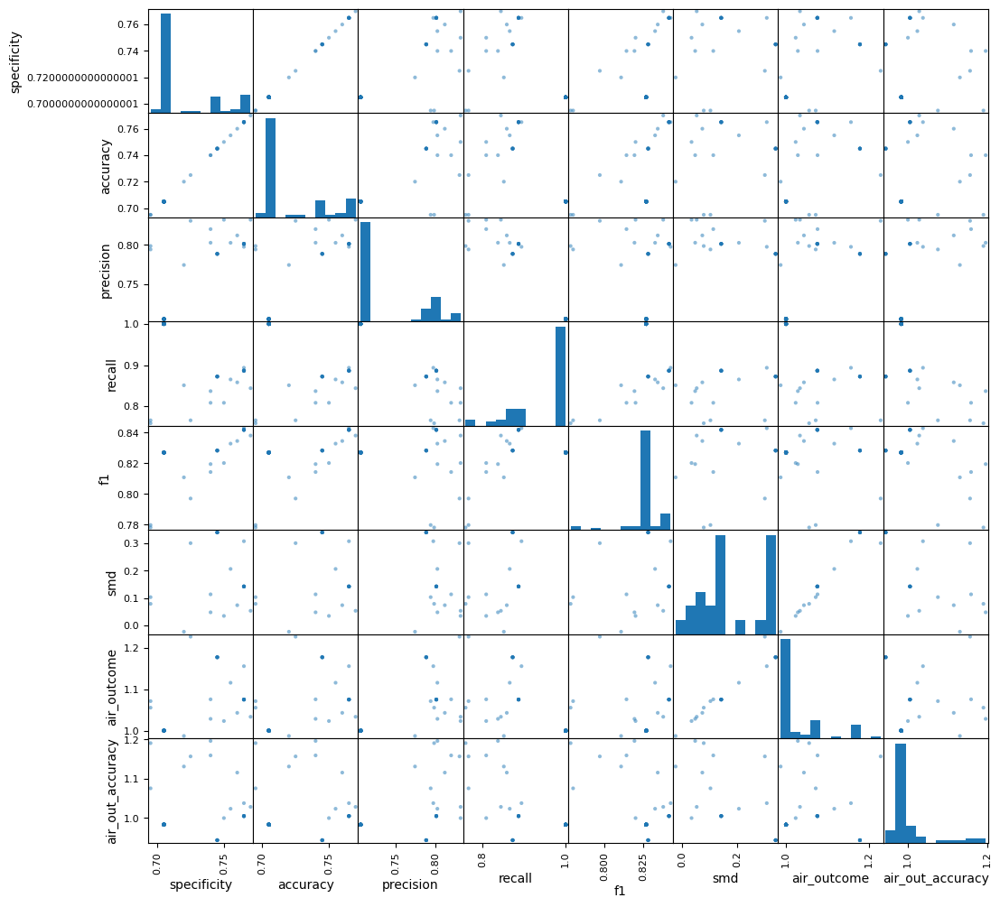

In [277]:
standard_metrics = ["specificity", "accuracy", "precision", "recall", "f1", "smd", "air_outcome", "air_out_accuracy"]

# Plot scatter matrix
scatter_matrix = pd.plotting.scatter_matrix(df_kpi[standard_metrics], figsize=(20, 20), diagonal='hist')
plt.show()

# Neural Networks

### Standardization

In [66]:
X_train_nn = X_train.copy()
X_test_nn = X_test.copy()

scaler = StandardScaler()

X_train_standardized = scaler.fit_transform(X_train_nn)
X_test_standardized = scaler.fit_transform(X_test_nn)

pd.DataFrame(X_train_standardized, columns=X_train.columns).describe()



,checking_account_value,duration,credit_amount,bonds,present_employment_since,rate_percentange_on_salary,present_residence_since,age,n_bank_existing_credits,n_people_liable,...,Other_installment_plans_A141,Other_installment_plans_A142,Other_installment_plans_A143,housing_A151,housing_A152,housing_A153,job_A171,job_A172,job_A173,job_A174
count,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,...,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02,8.000000e+02
mean,4.218847e-17,9.769963e-17,-1.776357e-17,3.552714e-17,8.881784e-17,1.465494e-16,2.664535e-17,-3.075318e-16,2.242651e-16,-8.437695e-17,...,-7.771561e-18,-2.664535e-17,1.065814e-16,2.775558e-18,-1.054712e-16,-6.217249e-17,3.552714e-17,-3.552714e-17,4.218847e-17,1.554312e-17
std,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,...,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00,1.000626e+00
min,-1.030445e+00,-1.448750e+00,-1.073974e+00,-3.963318e-01,-1.314556e+00,-1.751413e+00,-1.671440e+00,-1.451955e+00,-7.109315e-01,-4.097355e-01,...,-3.971680e-01,-2.138963e-01,-2.134375e+00,-4.605662e-01,-1.588782e+00,-3.493131e-01,-1.473478e-01,-4.803845e-01,-1.308382e+00,-4.364358e-01
25%,-1.030445e+00,-7.707739e-01,-6.838296e-01,-3.885513e-01,-6.111145e-01,-8.601085e-01,-7.661239e-01,-7.504744e-01,-7.109315e-01,-4.097355e-01,...,-3.971680e-01,-2.138963e-01,4.685213e-01,-4.605662e-01,-1.588782e+00,-3.493131e-01,-1.473478e-01,-4.803845e-01,-1.308382e+00,-4.364358e-01
50%,1.436615e-02,-2.622919e-01,-3.547963e-01,-3.885513e-01,-6.111145e-01,3.119565e-02,1.391924e-01,-2.243641e-01,-7.109315e-01,-4.097355e-01,...,-3.971680e-01,-2.138963e-01,4.685213e-01,-4.605662e-01,6.294129e-01,-3.493131e-01,-1.473478e-01,-4.803845e-01,7.643026e-01,-4.364358e-01
75%,1.059177e+00,2.461900e-01,2.740959e-01,-3.885513e-01,1.499209e+00,9.224998e-01,1.044509e+00,5.648013e-01,1.017777e+00,-4.097355e-01,...,-3.971680e-01,-2.138963e-01,4.685213e-01,-4.605662e-01,6.294129e-01,-3.493131e-01,-1.473478e-01,-4.803845e-01,7.643026e-01,-4.364358e-01
max,2.103989e+00,3.297082e+00,5.200792e+00,3.501727e+00,1.499209e+00,9.224998e-01,1.044509e+00,3.458408e+00,4.475195e+00,2.440599e+00,...,2.517826e+00,4.675162e+00,4.685213e-01,2.171241e+00,6.294129e-01,2.862761e+00,6.786665e+00,2.081666e+00,7.643026e-01,2.291288e+00


In [71]:
X_train_standardized

array([[ 0.01436615,  3.29708155,  1.19991221, ..., -0.48038446,
         0.76430257, -0.43643578],
       [ 2.10398855, -0.00805096, -0.35962991, ..., -0.48038446,
         0.76430257, -0.43643578],
       [-1.03044504, -1.27925578, -0.73354714, ..., -0.48038446,
         0.76430257, -0.43643578],
       ...,
       [-1.03044504,  0.24619   ,  0.84360327, ..., -0.48038446,
         0.76430257, -0.43643578],
       [ 1.05917735, -0.77077385, -0.64792251, ..., -0.48038446,
         0.76430257, -0.43643578],
       [-1.03044504, -1.27925578, -0.83850636, ..., -0.48038446,
         0.76430257, -0.43643578]])

In [79]:
X_train_nn

,checking_account_value,duration,credit_amount,bonds,present_employment_since,rate_percentange_on_salary,present_residence_since,age,n_bank_existing_credits,n_people_liable,...,Other_installment_plans_A141,Other_installment_plans_A142,Other_installment_plans_A143,housing_A151,housing_A152,housing_A153,job_A171,job_A172,job_A173,job_A174
29,1,60,6836,0,7,3,4,63,2,1,...,0,0,1,0,1,0,0,0,1,0
535,3,21,2319,0,0,2,1,33,1,1,...,0,0,1,1,0,0,0,0,1,0
695,0,6,1236,500,1,2,4,50,1,1,...,0,0,1,1,0,0,0,0,1,0
557,0,21,5003,-1,1,1,4,29,2,1,...,1,0,0,0,1,0,0,0,1,0
836,0,12,886,-1,1,4,2,21,1,1,...,0,0,1,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,0,18,6458,0,7,2,4,39,2,2,...,1,0,0,0,1,0,0,0,0,1
270,0,18,2662,-1,4,4,3,32,1,1,...,0,0,1,0,1,0,0,0,1,0
860,0,24,5804,100,1,4,2,27,2,1,...,0,0,1,0,1,0,0,0,1,0
435,2,12,1484,-1,1,2,1,25,1,1,...,0,0,1,0,1,0,0,0,1,0


In [90]:
y_test_nn.shape

(200,)

### NN Tuning

### Moving Tuninig within validation

In [84]:
import itertools
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import accuracy_score
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.optimizers import Adam, SGD, RMSprop
from keras.regularizers import l1, l2

nn_result = {
    "columns_removed": [],
    "units": [],
    "activation": [],
    "optimizer": [],
    "batch_size": [],
    "epochs": [],
    "learning_rate": [],
    "kernel_regularizer": [],
    "accuracy" : [],
    "specificity" : [],
    "precision" : [],
    "recall" : [],
    "f1" : [],
    "smd" : [],
    "air_outcome" : [],
    "air_out_accuracy" : [],
    "accuracy_confidence" : [],
    "specificity_confidence" : [],
    "precision_confidence" : [],
    "recall_confidence" : [],
    "f1_confidence" : [],
    "smd_confidence" : [],
    "air_outcome_confidence" : [],
    "air_out_accuracy_confidence" : []
}

units_list = [32, 49, 64]
activation_list = ['relu']
optimizer_list = [Adam, SGD]
batch_size_list = [16, 32]
epochs_list = [15]
kernel_regularizer_list = [None, l1, l2]
learning_rate_list = [0.1, 0.0001]
columns_removed = [None, ['sex'], ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'],
                  ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94']]

# X_train, X_val, y_train, y_val = train_test_split(X_train_standardized, y_train_nn, test_size=0.2, random_state=42)

skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
scaler = StandardScaler()

for params in itertools.product(units_list, activation_list, optimizer_list,
                                batch_size_list, epochs_list, kernel_regularizer_list, 
                                learning_rate_list, columns_removed):
    units_val, activation_val, optimizer_val, batch_size_val, epochs_val, \
    kernel_regularizer_val, learning_rate_val, column_removed = params
    
    
    X_train_nn = X_train.copy()
    
    if column_removed != None:
        
        X_train_copy = X_train_nn.drop(columns=column_removed)
        X_train_copy = scaler.fit_transform(X_train_copy)
    else:
        X_train_copy = scaler.fit_transform(X_train_nn)
    
    model = Sequential()
    
    # Explicitly set kernel_regularizer to None if kernel_regularizer_val is None
    if kernel_regularizer_val is None:
        model.add(Dense(units=units_val, activation=activation_val, input_dim=X_train_copy.shape[1]))
    else:
        model.add(Dense(units=units_val, activation=activation_val, input_dim=X_train_copy.shape[1], kernel_regularizer=kernel_regularizer_val()))
    
    model.add(Dense(units=1, activation='sigmoid'))

    if optimizer_val == Adam:
        optimizer = Adam(learning_rate=learning_rate_val)
    elif optimizer_val == SGD:
        optimizer = SGD(learning_rate=learning_rate_val)
    elif optimizer_val == RMSprop:
        optimizer = RMSprop(learning_rate=learning_rate_val)

    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    validation_accuracies = []
    validation_specificities = []
    validation_precisions = []
    validation_recalls = []
    validation_f1s = []

    validation_smds = []
    validation_air_outcomes = []
    validation_air_accuracies = []
    
    # VALIDATION
    for train_index, val_index in skf.split(X_train_copy, y_train):
        X_train_fold, X_val_fold = X_train_copy[train_index], X_train_copy[val_index]
        y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

        model.fit(X_train_fold, y_train_fold, epochs=epochs_val, batch_size=batch_size_val, verbose=0)
        
        # get original
        X_val_fold_original = X_train.iloc[val_index]

        y_pred_val = (model.predict(X_val_fold) > 0.5).astype(int).flatten()
        
        # Performance Metrics
        specificity, accuracy, precision, recall, f1 = get_metrics(y_val_fold, y_pred_val)

        # Fairness Metrics
        conc_result_df = get_final_result_df(y_val_fold, y_pred_val, X_val_fold_original)                        
        smd = standardized_mean_difference(conc_result_df, 'sex', 0, 1, 'prediction')
        air_outcome, air_out_accuracy = adverse_impacat_ratio(conc_result_df, 'sex', 0, 1, 'prediction', 1)


        validation_accuracies.append(accuracy)
        validation_specificities.append(specificity)
        validation_precisions.append(precision)
        validation_recalls.append(recall)
        validation_f1s.append(f1)
        validation_smds.append(smd)
        validation_air_outcomes.append(air_outcome)
        validation_air_accuracies.append(air_out_accuracy)
            
    val_acc_mean = np.mean(validation_accuracies)
    val_spec_mean = np.mean(validation_specificities)
    val_prec_mean = np.mean(validation_precisions)
    val_rec_mean = np.mean(validation_recalls)
    val_f1_mean = np.mean(validation_f1s)
    val_smd_mean = np.mean(validation_smds)
    val_air_mean = np.mean(validation_air_outcomes)
    val_air_acc_mean = np.mean(validation_air_accuracies)

    # Hyperparameters
    if column_removed != None: 
        nn_result["columns_removed"].append(', '.join(column_removed))
    else:
        nn_result["columns_removed"].append("None")

    nn_result["units"].append(units_val)
    nn_result["activation"].append(activation_val)
    nn_result["optimizer"].append(optimizer_val.__name__)
    nn_result["batch_size"].append(batch_size_val)
    nn_result["epochs"].append(epochs_val)  
    nn_result["learning_rate"].append(learning_rate_val)
    # Append None if kernel_regularizer_val is None, otherwise, append its name
    nn_result["kernel_regularizer"].append(kernel_regularizer_val.__name__ if kernel_regularizer_val else None)
    
    
    # Performance metrics
    nn_result["accuracy_confidence"].append(get_confindence_interval(validation_accuracies))
    nn_result["accuracy"].append(val_acc_mean)
    nn_result["specificity_confidence"].append(get_confindence_interval(validation_specificities))
    nn_result["specificity"].append(val_spec_mean)
    nn_result["precision_confidence"].append(get_confindence_interval(validation_precisions))
    nn_result["precision"].append(val_prec_mean)
    nn_result["recall_confidence"].append(get_confindence_interval(validation_recalls))
    nn_result["recall"].append(val_rec_mean)
    nn_result["f1_confidence"].append(get_confindence_interval(validation_f1s))
    nn_result["f1"].append(val_f1_mean)
    nn_result["smd_confidence"].append(get_confindence_interval(validation_smds))
    nn_result["smd"].append(val_smd_mean)
    nn_result["air_outcome_confidence"].append(get_confindence_interval(validation_air_outcomes))
    nn_result["air_outcome"].append(val_air_mean)
    nn_result["air_out_accuracy_confidence"].append(get_confindence_interval(validation_air_accuracies))
    nn_result["air_out_accuracy"].append(val_air_acc_mean)

    print("End parameters:", params)

print("End hyperparameter tuning for Keras sequential model.")

df_kpi_nn = pd.DataFrame(nn_result)
df_kpi_nn.describe()

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 10ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 10ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 598us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 5ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 10ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 10ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 10ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 976us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (32, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 7ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 903us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 949us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 7ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 9ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 603us/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 529us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (49, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 6ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 990us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 930us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 575us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 995us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 771us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 234us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 67us/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 838us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.adam.Adam'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 16, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 77us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, None, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L1'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 2ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.1, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 5ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 8ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, None)


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 3ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 14us/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 1ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 0s/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


3/3 [==============================] - 0s 4ms/step
End parameters: (64, 'relu', <class 'keras.src.optimizers.sgd.SGD'>, 32, 15, <class 'keras.src.regularizers.L2'>, 0.0001, ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'])
End hyperparameter tuning for Keras sequential model.


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

,units,batch_size,epochs,learning_rate,accuracy,specificity,precision,recall,f1,smd,air_outcome,air_out_accuracy
count,288.000000,288.000000,288.0,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000,269.000000,288.000000,288.000000
mean,48.333333,24.000000,15.0,0.050050,0.690326,0.548631,0.740835,0.776611,0.751601,-0.756508,0.628000,0.882054
std,13.095202,8.013925,0.0,0.050037,0.101440,0.161847,0.078940,0.121732,0.097575,0.546900,0.274145,0.119367
min,32.000000,16.000000,15.0,0.000100,0.423750,0.099570,0.569118,0.188490,0.276493,-2.015006,0.194120,0.606057
25%,32.000000,16.000000,15.0,0.000100,0.633750,0.455188,0.694517,0.724041,0.718322,-1.204411,0.420513,0.827675
50%,49.000000,24.000000,15.0,0.050050,0.695000,0.564839,0.743575,0.812184,0.768168,-0.851702,0.510287,0.873147
75%,64.000000,32.000000,15.0,0.100000,0.746563,0.634005,0.775129,0.852898,0.803658,-0.255110,0.868490,0.926664
max,64.000000,32.000000,15.0,0.100000,0.920000,0.906022,0.938057,0.949878,0.933050,0.548072,1.689522,1.844450


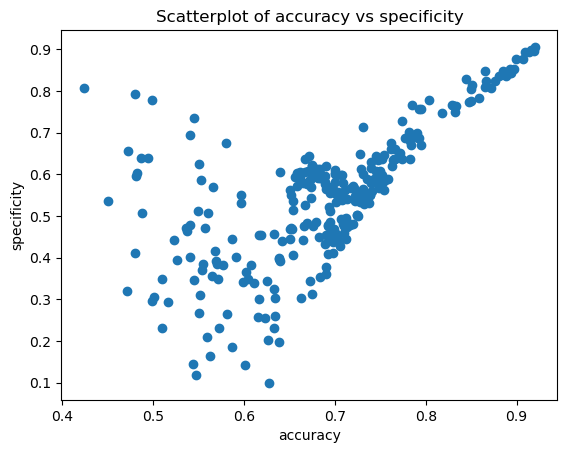

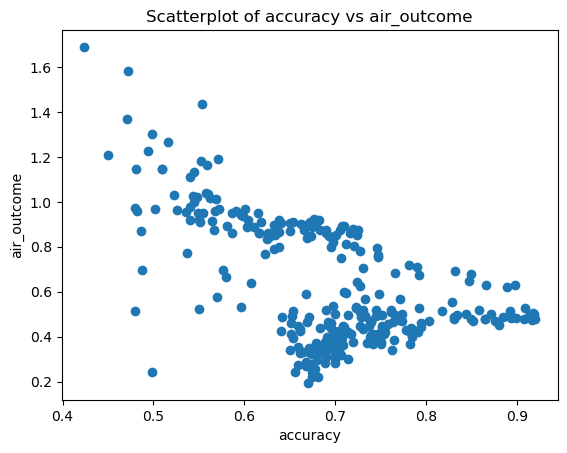

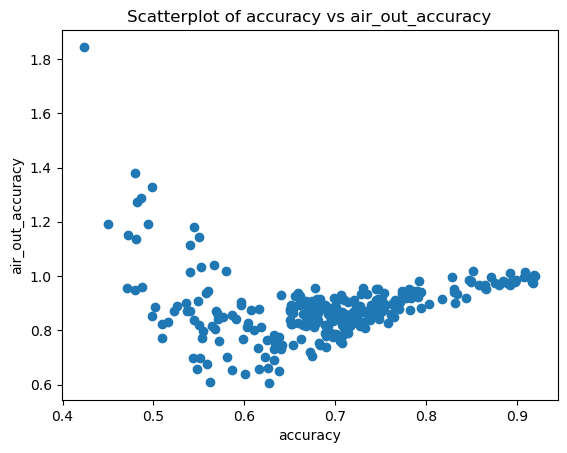

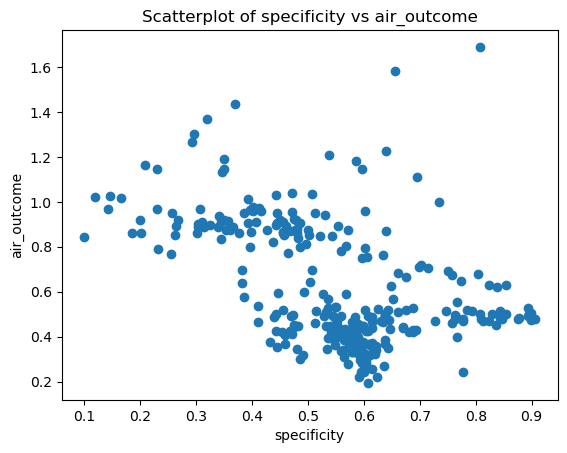

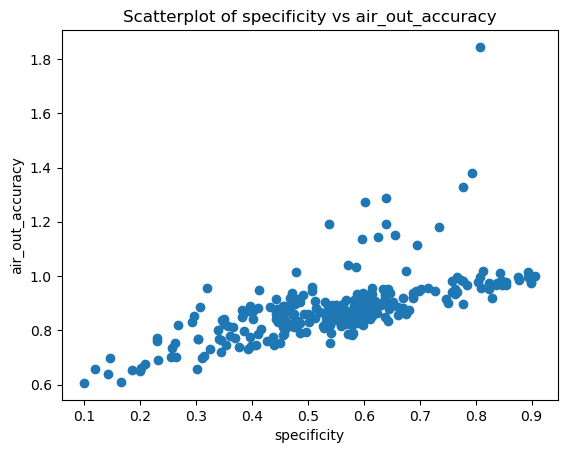

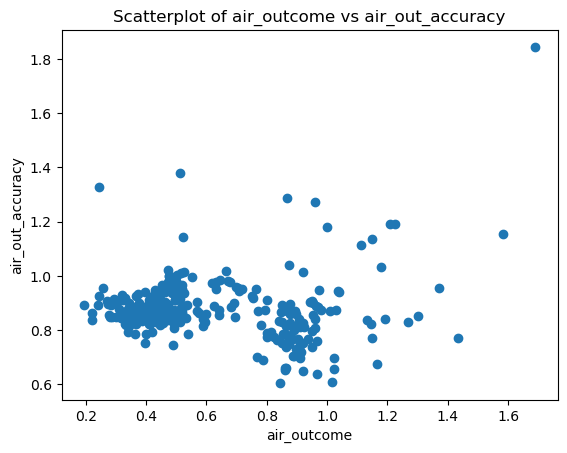

In [85]:
kpis = ['accuracy', 'specificity', 'air_outcome', 'air_out_accuracy']

done_1 = []

for col in kpis:
    
    for col_2 in kpis:
        if col !=  col_2 and col_2 not in done_1:
            plt.scatter(df_kpi_nn[col], df_kpi_nn[col_2] )
            plt.title(f'Scatterplot of {col} vs {col_2}')
            plt.xlabel(col)
            plt.ylabel(col_2)
            plt.show()
            
            done_1.append(col)

### TEST NEURAL NETWORKS

In [107]:
df_kpi_nn[df_kpi_nn['specificity'] >= 0.60]\
    [df_kpi_nn['accuracy'] >= 0.60]\
    [df_kpi_nn['air_outcome'] > 0.79]\
    [df_kpi_nn['air_out_accuracy'] > 0.79]

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1506706822.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_kpi_nn[df_kpi_nn['specificity'] >= 0.60]\


,columns_removed,units,activation,optimizer,batch_size,epochs,learning_rate,kernel_regularizer,accuracy,specificity,...,air_outcome,air_out_accuracy,accuracy_confidence,specificity_confidence,precision_confidence,recall_confidence,f1_confidence,smd_confidence,air_outcome_confidence,air_out_accuracy_confidence
187,"sex, status_and_sex_A91, status_and_sex_A92, s...",49,relu,SGD,32,15,0.1,2,0.74625,0.601398,...,0.794568,0.873859,"(0.7117436135346981, 0.7807563864653019)","(0.527984339792968, 0.674811359131763)","(0.7425454949875969, 0.8117663458436084)","(0.7946534127926514, 0.8745710770032671)","(0.774790174062157, 0.8311102617335098)","(-0.44894986246076435, -0.20937598413813138)","(0.7270474135781417, 0.8620882137841395)","(0.8233485219488895, 0.9243685000862057)"


In [117]:
column_removed = ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94']

X_train_nn = X_train.copy()    
X_train_copy = X_train_nn.drop(columns=column_removed)
X_train_copy = scaler.fit_transform(X_train_copy)

X_test_nn = X_test.copy()
X_test_copy = X_test_nn.drop(columns=column_removed)
X_test_copy = scaler.fit_transform(X_test_copy)


model = Sequential()
model.add(Dense(units=49, activation='relu', input_dim=X_train_copy.shape[1], kernel_regularizer=l2()))
model.add(Dense(units=1, activation='sigmoid'))

optimizer = SGD(learning_rate=0.1)

model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

model.fit(X_train_copy, y_train, epochs=15, batch_size=32, verbose=0)

y_pred_val = (model.predict(X_test_copy) > 0.5).astype(int).flatten()

# Performance Metrics
specificity, accuracy, precision, recall, f1 = get_metrics(y_test, y_pred_val)

# Fairness Metrics
conc_result_df = get_final_result_df(y_test, y_pred_val, X_test)                        
smd = standardized_mean_difference(conc_result_df, 'sex', 0, 1, 'prediction')
air_outcome, air_out_accuracy = adverse_impacat_ratio(conc_result_df, 'sex', 0, 1, 'prediction', 1)

print(f"specificity: {specificity}")
print(f"accuracy: {accuracy}")
print(f"precision: {precision}")
print(f"recall: {recall}")
print(f"f1: {f1}")
print(f"smd: {smd}")
print(f"air_outcome: {air_outcome}")
print(f"air_out_accuracy: {air_out_accuracy}")
print(f"confusion matrix: \n{confusion_matrix(y_test, y_pred_val)}")

7/7 [==============================] - 0s 3ms/step
specificity: 0.5135135135135135
accuracy: 0.675
precision: 0.7293233082706767
recall: 0.7698412698412699
f1: 0.7490347490347491
smd: -0.012599315749741897
air_outcome: 0.9910714285714286
air_out_accuracy: 0.8319327731092436
confusion matrix: 
[[38 36]
 [29 97]]


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


In [88]:
df_kpi_nn.columns

Index(['columns_removed', 'units', 'activation', 'optimizer', 'batch_size',
       'epochs', 'learning_rate', 'kernel_regularizer', 'accuracy',
       'specificity', 'precision', 'recall', 'f1', 'smd', 'air_outcome',
       'air_out_accuracy', 'accuracy_confidence', 'specificity_confidence',
       'precision_confidence', 'recall_confidence', 'f1_confidence',
       'smd_confidence', 'air_outcome_confidence',
       'air_out_accuracy_confidence'],
      dtype='object')

In [100]:
df_kpi_nn = pd.DataFrame(nn_result)

def convert_kernel_regularizer(kr):
    if kr == None:
        return 0
    elif kr == 'L1':
        return 1
    elif kr == 'L2':
        return 2
    else:
        raise Exception(kr)
df_kpi_nn['kernel_regularizer'] = df_kpi_nn['kernel_regularizer'].apply(lambda x: convert_kernel_regularizer(x))

columns_removed


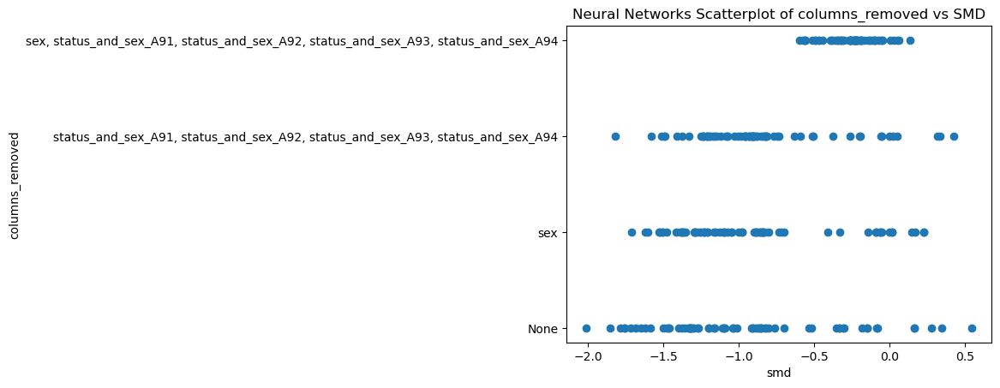

units


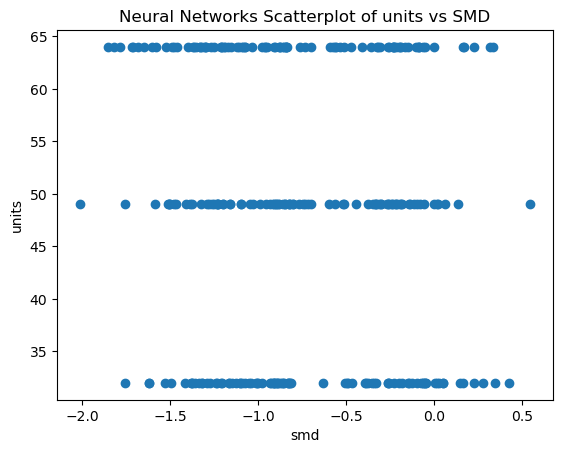

activation


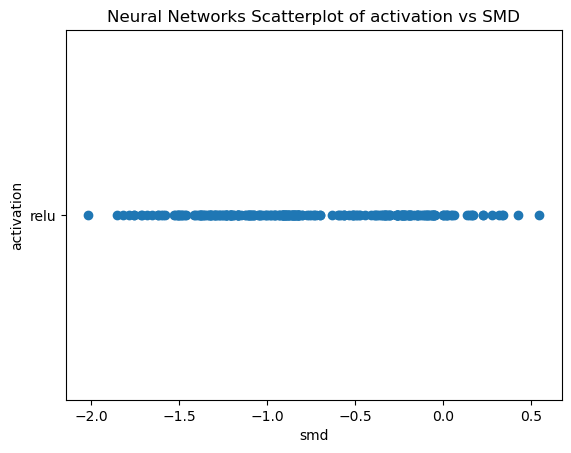

optimizer


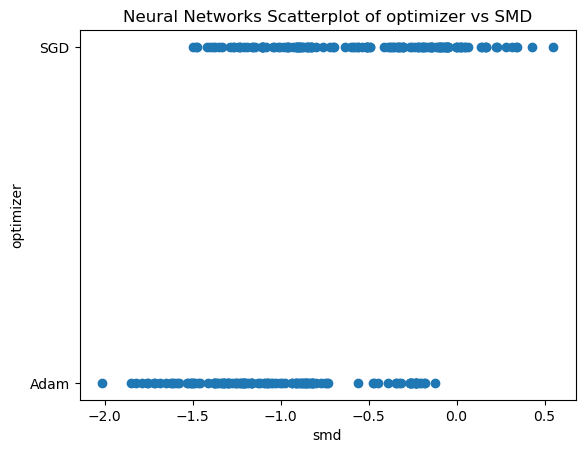

batch_size


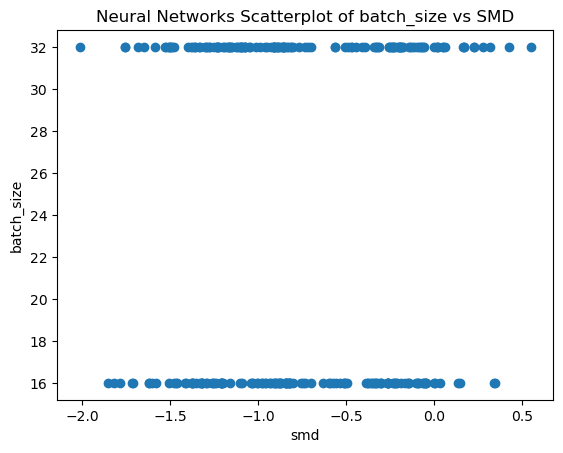

epochs


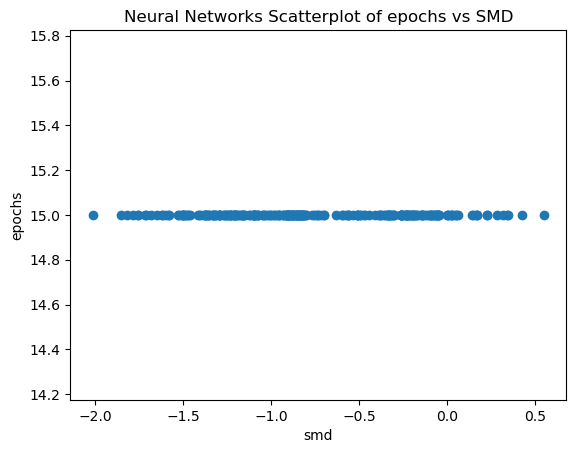

learning_rate


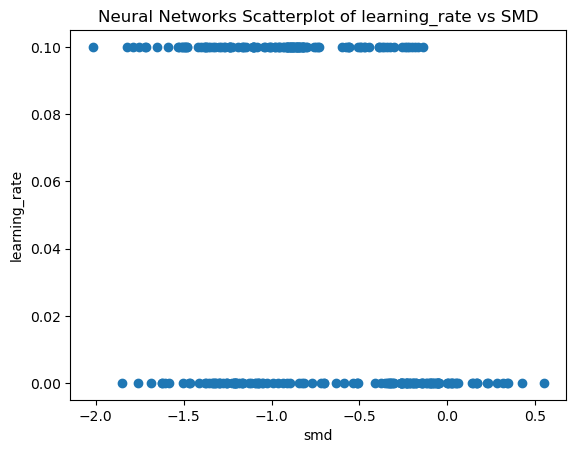

kernel_regularizer


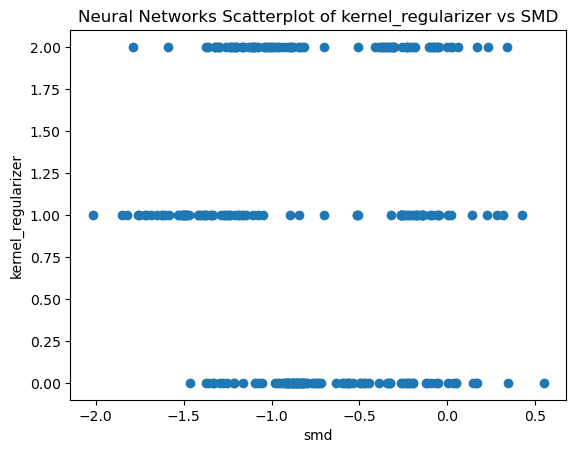

In [101]:

for kpi in ['columns_removed', 'units', 'activation', 'optimizer', 'batch_size', 'epochs', 'learning_rate', 'kernel_regularizer']:
    print(kpi)

    plt.scatter(df_kpi_nn["smd"], df_kpi_nn[kpi]  )
    plt.title(f'Neural Networks Scatterplot of {kpi} vs SMD')
    plt.xlabel("smd")
    plt.ylabel(kpi)
    plt.show()
    

# Analysis on Biased Dataframes

In [204]:
biased_df_02_encoded = encode_all(biased_df_02)

X_biased = biased_df_02_encoded.drop('credit_risk', axis=1)
y_biased = biased_df_02_encoded['credit_risk']

X_train_biased, X_test_biased, y_train_biased, y_test_biased = train_test_split(X_biased, y_biased, test_size=0.2, random_state=42)

TypeError: 'int' object is not subscriptable

In [154]:

def dct_validation(X_train, y_train):

    result = {
        "columns_removed": [],
        "class_weight": [],
        "max_depth" : [],
        "criterion" : [],
        "ccp_alpha" : [],
        "accuracy" : [],
        "specificity" : [],
        "precision" : [],
        "recall" : [],
        "f1" : [],
        "smd" : [],
        "air_outcome" : [],
        "air_out_accuracy" : [],
        "accuracy_confidence" : [],
        "specificity_confidence" : [],
        "precision_confidence" : [],
        "recall_confidence" : [],
        "f1_confidence" : [],
        "smd_confidence" : [],
        "air_outcome_confidence" : [],
        "air_out_accuracy_confidence" : []
    }

    class_weight_list = [None, "balanced"]
    max_depth_list = [2, 3, 5, 7, 10, 50, None] 
    criterion_list = ['gini', 'entropy']
    ccp_alpha_list = [0.0, 0.01, 0.05, 0.2, 0.25, 0.3]  
    columns_removed = [None, ['sex'], ['status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94'],
                      ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94']]

    skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

    for column_removed in columns_removed:
        X_train_copy = X_train.copy()

        if column_removed != None:

            X_train_copy = X_train_copy.drop(columns=column_removed)       

        for class_weight in class_weight_list:
            for max_depth_val in max_depth_list:
                for criterion_val in criterion_list:
                    for ccp_alpha_val in ccp_alpha_list:
                        clf = DecisionTreeClassifier(class_weight=class_weight, 
                                                 max_depth=max_depth_val, 
                                                 ccp_alpha=ccp_alpha_val, 
                                                 criterion=criterion_val)

                        validation_accuracies = []
                        validation_specificities = []
                        validation_precisions = []
                        validation_recalls = []
                        validation_f1s = []

                        validation_smds = []
                        validation_air_outcomes = []
                        validation_air_accuracies = []

                        for train_index, val_index in skf.split(X_train_copy, y_train):
                            X_train_fold, X_val_fold = X_train_copy.iloc[train_index], X_train_copy.iloc[val_index]
                            y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

                            clf.fit(X_train_fold, y_train_fold)

                            y_pred_val = clf.predict(X_val_fold)

                            # get original with sex column
                            X_val_fold_original = X_train.iloc[val_index]

                            # Performance Metrics
                            specificity, accuracy, precision, recall, f1 = get_metrics(y_val_fold, y_pred_val)

                            # Fairness Metrics --> computed with original
                            conc_result_df = get_final_result_df(y_val_fold, y_pred_val, X_val_fold_original)                        
                            smd = standardized_mean_difference(conc_result_df, 'sex', 0, 1, 'prediction')
                            air_outcome, air_out_accuracy = adverse_impacat_ratio(conc_result_df, 'sex', 0, 1, 'prediction', 1)


                            validation_accuracies.append(accuracy)
                            validation_specificities.append(specificity)
                            validation_precisions.append(precision)
                            validation_recalls.append(recall)
                            validation_f1s.append(f1)
                            validation_smds.append(smd)
                            validation_air_outcomes.append(air_outcome)
                            validation_air_accuracies.append(air_out_accuracy)


                        val_acc_mean = np.mean(validation_accuracies)
                        val_spec_mean = np.mean(validation_specificities)
                        val_prec_mean = np.mean(validation_precisions)
                        val_rec_mean = np.mean(validation_recalls)
                        val_f1_mean = np.mean(validation_f1s)
                        val_smd_mean = np.mean(validation_smds)
                        val_air_mean = np.mean(validation_air_outcomes)
                        val_air_acc_mean = np.mean(validation_air_accuracies)


                        # Hyperparameters
                        if column_removed != None: 
                            result["columns_removed"].append(', '.join(column_removed))
                        else:
                            result["columns_removed"].append("None")
                        result["class_weight"].append(class_weight)
                        result["max_depth"].append(max_depth_val)
                        result["criterion"].append(criterion_val)
                        result["ccp_alpha"].append(ccp_alpha_val)

                        result["accuracy_confidence"].append(get_confindence_interval(validation_accuracies))
                        result["accuracy"].append(val_acc_mean)
                        result["specificity_confidence"].append(get_confindence_interval(validation_specificities))
                        result["specificity"].append(val_spec_mean)
                        result["precision_confidence"].append(get_confindence_interval(validation_precisions))
                        result["precision"].append(val_prec_mean)
                        result["recall_confidence"].append(get_confindence_interval(validation_recalls))
                        result["recall"].append(val_rec_mean)
                        result["f1_confidence"].append(get_confindence_interval(validation_f1s))
                        result["f1"].append(val_f1_mean)
                        result["smd_confidence"].append(get_confindence_interval(validation_smds))
                        result["smd"].append(val_smd_mean)
                        result["air_outcome_confidence"].append(get_confindence_interval(validation_air_outcomes))
                        result["air_outcome"].append(val_air_mean)
                        result["air_out_accuracy_confidence"].append(get_confindence_interval(validation_air_accuracies))
                        result["air_out_accuracy"].append(val_air_acc_mean)
                        
                        
    return result


In [155]:
result = dct_validation(X_train_biased, y_train_biased)

biased_kpi = pd.DataFrame(result)

biased_kpi.describe()

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Lo

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

,max_depth,ccp_alpha,accuracy,specificity,precision,recall,f1,smd,air_outcome,air_out_accuracy
count,576.000000,672.000000,672.000000,672.000000,672.000000,672.000000,672.000000,245.000000,672.000000,672.000000
mean,12.833333,0.135000,0.633051,0.230565,0.682519,0.863232,0.738931,-inf,0.780198,0.699896
std,16.841357,0.119637,0.018030,0.305561,0.068880,0.189523,0.063860,NaN,0.323896,0.139307
min,2.000000,0.000000,0.578750,0.000000,0.636250,0.408431,0.555832,-inf,0.023553,0.599960
25%,3.000000,0.010000,0.636250,0.000000,0.636250,0.753549,0.729562,-1.593657,0.525366,0.599960
50%,6.000000,0.125000,0.636250,0.000000,0.636250,1.000000,0.777686,-0.893024,1.000000,0.599960
75%,10.000000,0.250000,0.636250,0.460920,0.711478,1.000000,0.777686,-0.512279,1.000000,0.784304
max,50.000000,0.300000,0.675000,0.903793,0.885391,1.000000,0.777686,-0.046523,1.000000,1.104073


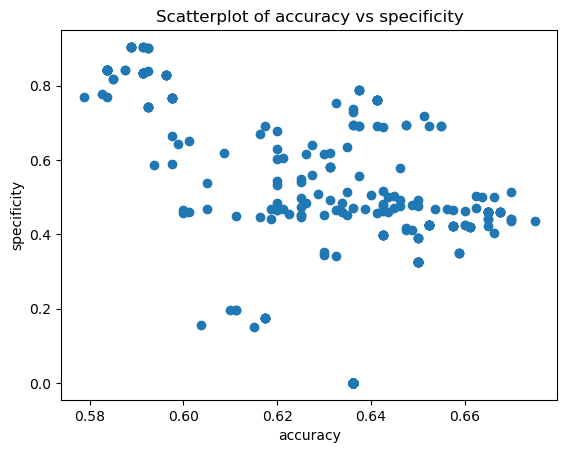

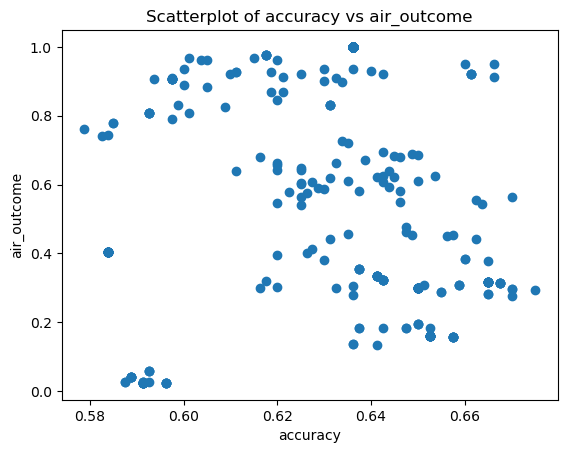

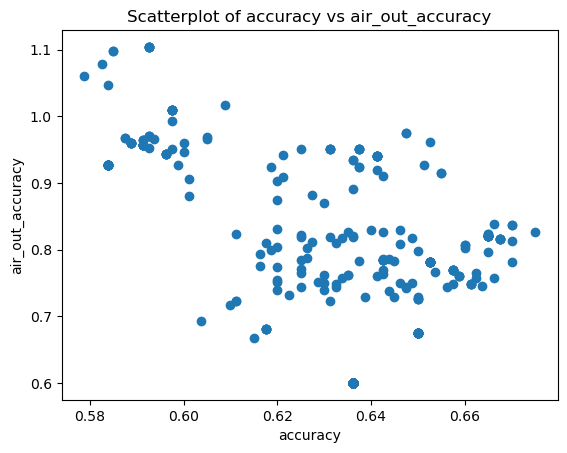

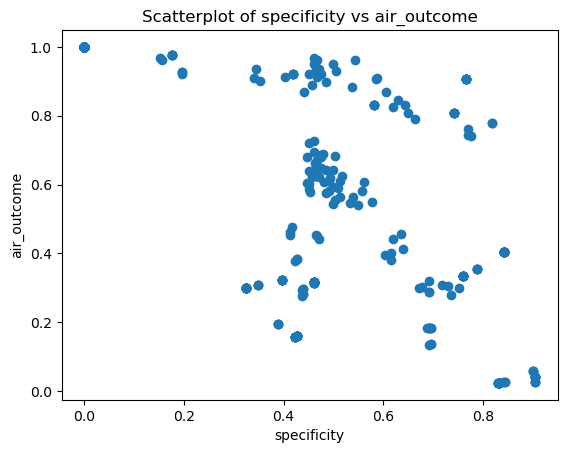

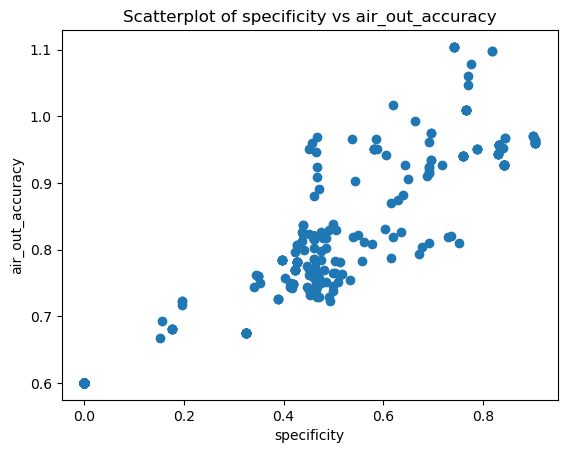

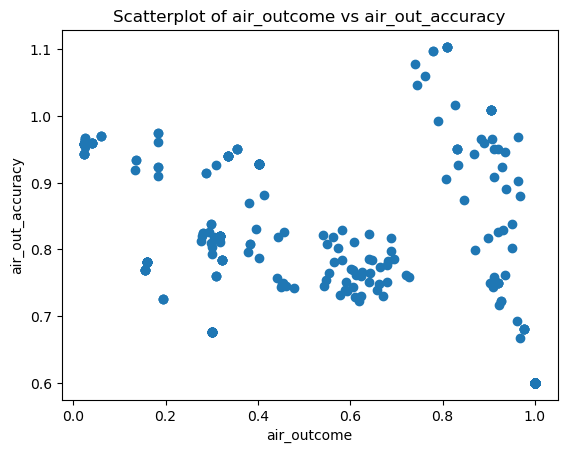

In [156]:
kpis = ['accuracy', 'specificity', 'air_outcome', 'air_out_accuracy']

done_1 = []

for col in kpis:
    
    for col_2 in kpis:
        if col !=  col_2 and col_2 not in done_1:
            plt.scatter(biased_kpi[col], biased_kpi[col_2] )
            plt.title(f'Scatterplot of {col} vs {col_2}')
            plt.xlabel(col)
            plt.ylabel(col_2)
            plt.show()
            
            done_1.append(col)

In [157]:
biased_kpi[biased_kpi['specificity'] >= 0.60]\
    [biased_kpi['accuracy'] >= 0.60]\
    [biased_kpi['air_outcome'] > 0.79]\
    [biased_kpi['air_out_accuracy'] > 0.79]

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\877973590.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  biased_kpi[biased_kpi['specificity'] >= 0.60]\


,columns_removed,class_weight,max_depth,criterion,ccp_alpha,accuracy,specificity,precision,recall,f1,...,air_outcome,air_out_accuracy,accuracy_confidence,specificity_confidence,precision_confidence,recall_confidence,f1_confidence,smd_confidence,air_outcome_confidence,air_out_accuracy_confidence
600,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,3.0,gini,0.00,0.60125,0.650115,0.753493,0.573647,0.640704,...,0.806959,0.905656,"(0.5698598923953018, 0.6326401076046984)","(0.552264190740603, 0.7479656943168682)","(0.7093715842544365, 0.797613893457334)","(0.5041422264710088, 0.64315189117605)","(0.5964530024879116, 0.6849555184494025)","(-0.4377287720369898, -0.030870136218380195)","(0.6485285592829337, 0.965389767403755)","(0.8007072195197251, 1.0106051394569873)"
612,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,5.0,gini,0.00,0.62000,0.629080,0.740916,0.614471,0.667211,...,0.846226,0.874214,"(0.573264606928899, 0.6667353930711007)","(0.575006456239557, 0.683154463300673)","(0.7025839602756596, 0.7792480393008785)","(0.5399481543766562, 0.6889930220939318)","(0.6128273730736228, 0.721594683529895)","(-0.31703212400496245, -0.06513226195541363)","(0.7516424088215238, 0.9408095930683515)","(0.7481172762806133, 1.0003114081661797)"
619,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,5.0,entropy,0.01,0.60875,0.618851,0.740630,0.602902,0.653201,...,0.826788,1.016938,"(0.5745834188244263, 0.6429165811755735)","(0.5308612615839742, 0.7068398878413132)","(0.7103246534022607, 0.7709350076107944)","(0.5168481349864819, 0.6889557865821455)","(0.5999847791098316, 0.7064176788781202)","(-0.26413800198759907, -0.12813713694556955)","(0.7715056992542664, 0.8820700328966506)","(0.9023349213123599, 1.1315410316145424)"
624,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,7.0,gini,0.00,0.62125,0.605402,0.738512,0.630588,0.676229,...,0.868705,0.942527,"(0.5870834188244264, 0.6554165811755736)","(0.5427007675686043, 0.6681038301325452)","(0.708715575710675, 0.7683079900511204)","(0.573794139152475, 0.6873823314357603)","(0.6391994610339669, 0.7132595326080562)","(-0.22850891659610967, -0.07257072793574161)","(0.7981931025733586, 0.939216654477416)","(0.7961573911373412, 1.0888959626919297)"


In [185]:
clf = DecisionTreeClassifier(class_weight='balanced', 
                                             max_depth=5, 
                                             ccp_alpha=0.0, 
                                             criterion='gini')

columns_to_removed = ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94']

X_train_biased_copy = X_train_biased.copy()
X_test_biased_copy = X_test_biased.copy()

X_train_biased_copy = X_train_biased_copy.drop(columns=columns_to_removed)
X_test_biased_copy = X_test_biased_copy.drop(columns=columns_to_removed)
# y_train_biased, y_test_biased

clf.fit(X_train_biased_copy, y_train_biased)

predictions = clf.predict(X_test_biased_copy)

# Performance Metrics
specificity, accuracy, precision, recall, f1 = get_metrics(y_test_biased, predictions)

# Fairness Metrics
conc_result_df = get_final_result_df(y_test_biased, predictions, X_test_biased)                        
smd = standardized_mean_difference(conc_result_df, 'sex', 0, 1, 'prediction')
air_outcome, air_out_accuracy = adverse_impacat_ratio(conc_result_df, 'sex', 0, 1, 'prediction', 1)

print(f"specificity: {specificity}")
print(f"accuracy: {accuracy}")
print(f"precision: {precision}")
print(f"recall: {recall}")
print(f"f1: {f1}")
print(f"smd: {smd}")
print(f"air_outcome: {air_outcome}")
print(f"air_out_accuracy: {air_out_accuracy}")
print(f"confusion matrix: \n{confusion_matrix(y_test_biased, predictions)}")

specificity: 0.676056338028169
accuracy: 0.625
precision: 0.77
recall: 0.5968992248062015
f1: 0.6724890829694323
smd: 0.2503238782975022
air_outcome: 1.2665245202558635
air_out_accuracy: 0.9607535321821036
confusion matrix: 
[[48 23]
 [52 77]]


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


In [186]:
biased_kpi.columns

Index(['columns_removed', 'class_weight', 'max_depth', 'criterion',
       'ccp_alpha', 'accuracy', 'specificity', 'precision', 'recall', 'f1',
       'smd', 'air_outcome', 'air_out_accuracy', 'accuracy_confidence',
       'specificity_confidence', 'precision_confidence', 'recall_confidence',
       'f1_confidence', 'smd_confidence', 'air_outcome_confidence',
       'air_out_accuracy_confidence'],
      dtype='object')

columns_removed


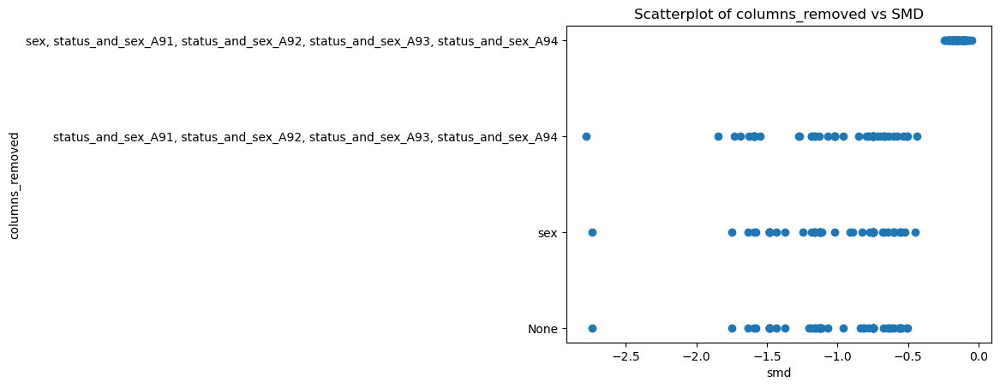

class_weight


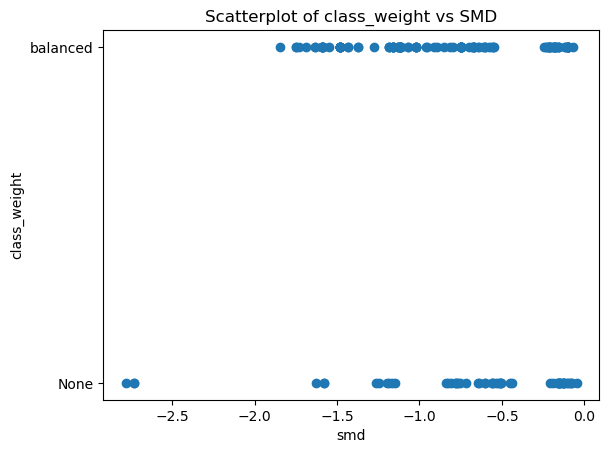

max_depth


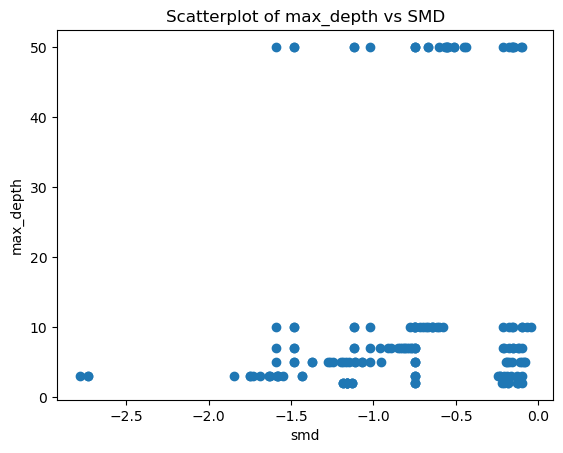

criterion


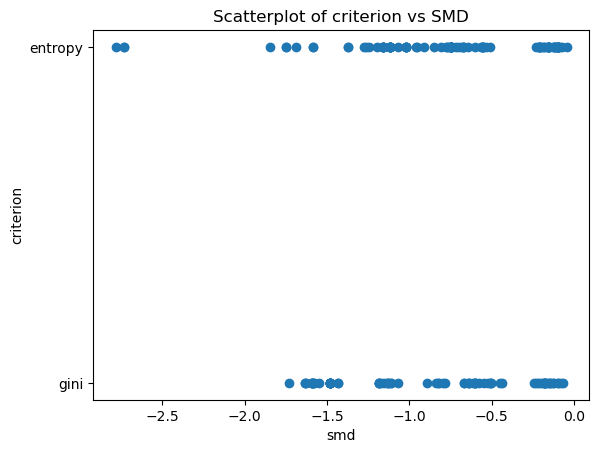

ccp_alpha


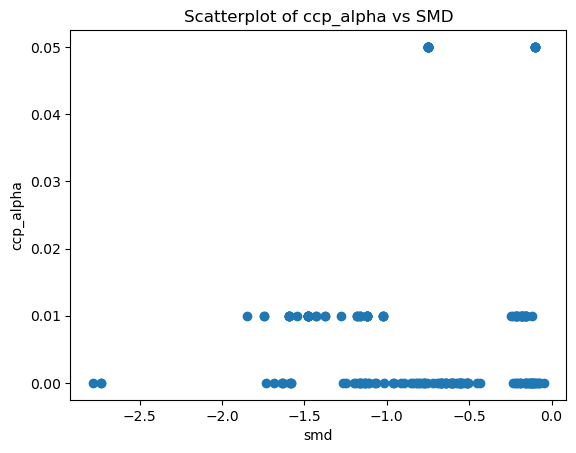

In [189]:
biased_kpi['class_weight'] = biased_kpi['class_weight'].apply(lambda x: "None" if x == None else x)

for kpi in ['columns_removed', 'class_weight', 'max_depth', 'criterion', 'ccp_alpha']:
    print(kpi)

    plt.scatter(biased_kpi["smd"], biased_kpi[kpi]  )
    plt.title(f'Scatterplot of {kpi} vs SMD')
    plt.xlabel("smd")
    plt.ylabel(kpi)
    plt.show()
    

In [193]:
biased_df_025_encoded = encode_all(biased_df_025)

X_biased_df_025 = biased_df_025_encoded.drop('credit_risk', axis=1)
y_biased_df_025 = biased_df_025_encoded['credit_risk']


X_train_025, X_test_025, y_train_025, y_test_025 = train_test_split(X_biased_df_025, y_biased_df_025, test_size=0.2, random_state=42)

In [194]:
result = dct_validation(X_train_025, y_train_025)

biased_kpi = pd.DataFrame(result)

biased_kpi.describe()

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to ma

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reind

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: User

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: User

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2351: RuntimeWarning: invalid value encountered in multiply
  lower_bound = _a * scale + loc
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2352: RuntimeWarning: invalid value encountered in multiply
  upper_bound = _b * scale + loc
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_po

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to ma

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reinde

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: Runtim

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Lo

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: User

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed 

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: Undefin

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2351: RuntimeWarning: invalid value encountered in multiply
  lower_bound = _a * scale + loc
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sci

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2351: RuntimeWarning: invalid value encountered in multiply
  lower_bound = _a * scale + loc
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2352: RuntimeWarning: invalid value encountered in multiply
  upper_bound = _b * scale + loc
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_po

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2351: RuntimeWarning: invalid value encountered in multiply
  lower_bound = _a * scale + loc
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sci

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: Undefin

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: Use

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: Use

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: User

,max_depth,ccp_alpha,accuracy,specificity,precision,recall,f1,smd,air_outcome,air_out_accuracy
count,576.000000,672.000000,672.000000,672.000000,672.000000,672.000000,672.000000,259.000000,469.000000,672.000000
mean,12.833333,0.135000,0.579628,0.454735,0.555929,0.657948,0.580574,-inf,0.611010,1.047675
std,16.841357,0.119637,0.083617,0.315535,0.234816,0.277169,0.221041,NaN,0.413382,0.502380
min,2.000000,0.000000,0.446250,0.000000,0.183750,0.300000,0.227907,-inf,0.000000,0.543642
25%,3.000000,0.010000,0.446250,0.000000,0.183750,0.300000,0.227907,-2.565007,0.192904,0.543642
50%,6.000000,0.125000,0.621250,0.541237,0.621250,0.686041,0.689217,-1.221647,0.800000,0.864878
75%,10.000000,0.250000,0.625000,0.700000,0.726241,1.000000,0.766369,-0.750421,1.000000,1.824906
max,50.000000,0.300000,0.688750,0.917527,0.891422,1.000000,0.766557,0.022300,1.034327,1.824906


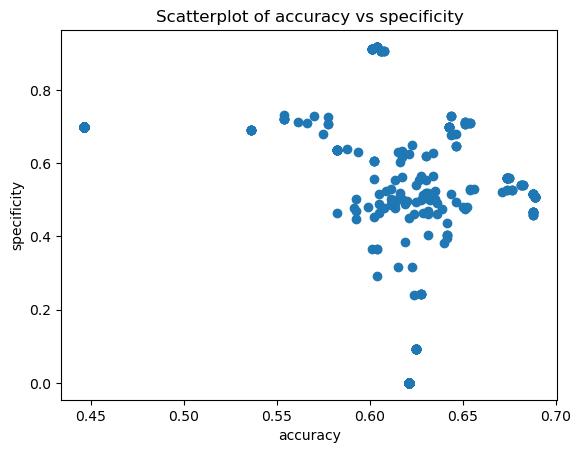

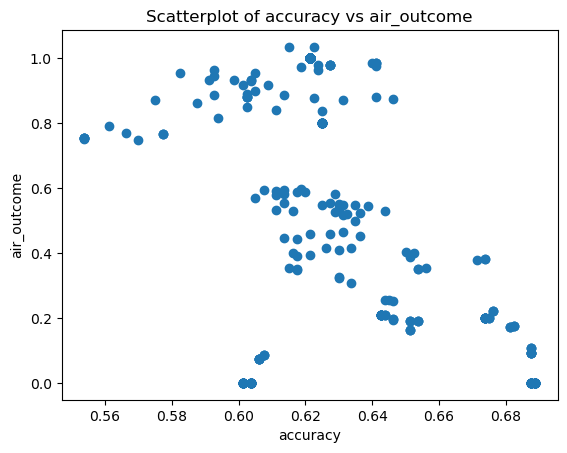

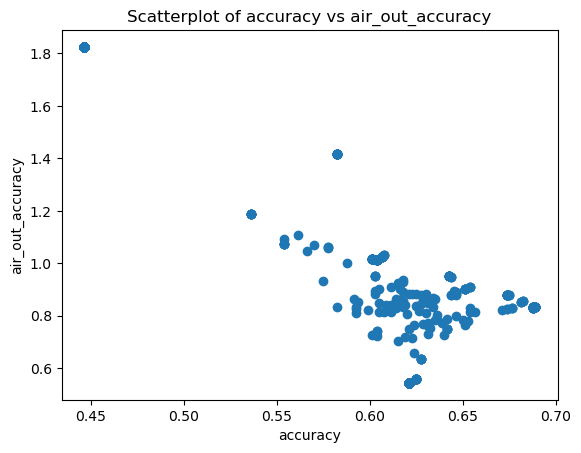

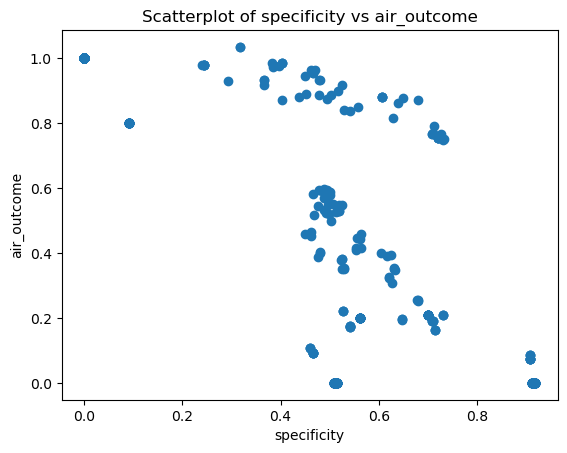

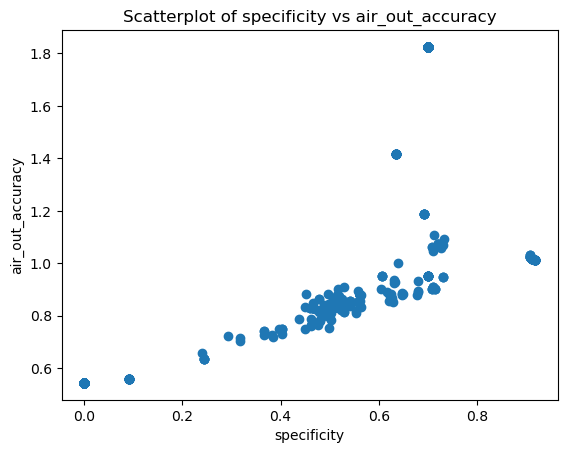

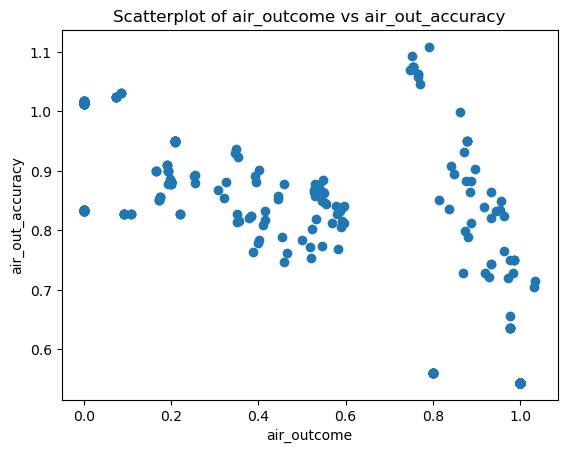

In [195]:
kpis = ['accuracy', 'specificity', 'air_outcome', 'air_out_accuracy']

done_1 = []

for col in kpis:
    
    for col_2 in kpis:
        if col !=  col_2 and col_2 not in done_1:
            plt.scatter(biased_kpi[col], biased_kpi[col_2] )
            plt.title(f'Scatterplot of {col} vs {col_2}')
            plt.xlabel(col)
            plt.ylabel(col_2)
            plt.show()
            
            done_1.append(col)

In [196]:
biased_kpi[biased_kpi['specificity'] >= 0.60]\
    [biased_kpi['accuracy'] >= 0.60]\
    [biased_kpi['air_outcome'] > 0.79]\
    [biased_kpi['air_out_accuracy'] > 0.79]

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\877973590.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  biased_kpi[biased_kpi['specificity'] >= 0.60]\


,columns_removed,class_weight,max_depth,criterion,ccp_alpha,accuracy,specificity,precision,recall,f1,...,air_outcome,air_out_accuracy,accuracy_confidence,specificity_confidence,precision_confidence,recall_confidence,f1_confidence,smd_confidence,air_outcome_confidence,air_out_accuracy_confidence
612,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,5.0,gini,0.00,0.6225,0.649355,0.744803,0.605265,0.661730,...,0.877031,0.883804,"(0.5906761411093542, 0.6543238588906459)","(0.5748913378302838, 0.7238183395890708)","(0.7109129183107923, 0.7786931893932987)","(0.5409371436698028, 0.6695934685750952)","(0.6245176760841252, 0.6989429054075599)","(-0.2912486602337221, 0.0026994194594131826)","(0.7446069103731526, 1.0094542771624748)","(0.7846487367208521, 0.9829583966833266)"
631,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,7.0,entropy,0.01,0.6025,0.606344,0.721918,0.599102,0.644311,...,0.878784,0.951051,"(0.5774455937366786, 0.6275544062633213)","(0.5222389173652402, 0.6904492546777705)","(0.6914553089786594, 0.7523798773403981)","(0.5209512000474752, 0.6772528815851777)","(0.5992637871138277, 0.6893582776887611)","(-0.37996291801665216, 0.009810284041871259)","(0.7185525621413107, 1.0390146513182366)","(0.8476396503604369, 1.0544623917701907)"
643,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,10.0,entropy,0.01,0.6025,0.606344,0.721918,0.599102,0.644311,...,0.878784,0.951051,"(0.5774455937366786, 0.6275544062633213)","(0.5222389173652402, 0.6904492546777705)","(0.6914553089786594, 0.7523798773403981)","(0.5209512000474752, 0.6772528815851777)","(0.5992637871138277, 0.6893582776887611)","(-0.37996291801665216, 0.009810284041871259)","(0.7185525621413107, 1.0390146513182366)","(0.8476396503604369, 1.0544623917701907)"
655,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,50.0,entropy,0.01,0.6025,0.606344,0.721918,0.599102,0.644311,...,0.878784,0.951051,"(0.5774455937366786, 0.6275544062633213)","(0.5222389173652402, 0.6904492546777705)","(0.6914553089786594, 0.7523798773403981)","(0.5209512000474752, 0.6772528815851777)","(0.5992637871138277, 0.6893582776887611)","(-0.37996291801665216, 0.009810284041871259)","(0.7185525621413107, 1.0390146513182366)","(0.8476396503604369, 1.0544623917701907)"
667,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,NaN,entropy,0.01,0.6025,0.606344,0.721918,0.599102,0.644311,...,0.878784,0.951051,"(0.5774455937366786, 0.6275544062633213)","(0.5222389173652402, 0.6904492546777705)","(0.6914553089786594, 0.7523798773403981)","(0.5209512000474752, 0.6772528815851777)","(0.5992637871138277, 0.6893582776887611)","(-0.37996291801665216, 0.009810284041871259)","(0.7185525621413107, 1.0390146513182366)","(0.8476396503604369, 1.0544623917701907)"


In [197]:
clf = DecisionTreeClassifier(class_weight='balanced', 
                                             max_depth=5, 
                                             ccp_alpha=0.0, 
                                             criterion='gini')

columns_to_removed = ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94']

X_train_biased_copy = X_train_025.copy()
X_test_biased_copy = X_test_025.copy()

X_train_biased_copy = X_train_biased_copy.drop(columns=columns_to_removed)
X_test_biased_copy = X_test_biased_copy.drop(columns=columns_to_removed)
# X_train_025, X_test_025, y_train_025, y_test_025

clf.fit(X_train_biased_copy, y_train_025)

predictions = clf.predict(X_test_biased_copy)

# Performance Metrics
specificity, accuracy, precision, recall, f1 = get_metrics(y_test_025, predictions)

# Fairness Metrics
conc_result_df = get_final_result_df(y_test_025, predictions, X_test_025)                        
smd = standardized_mean_difference(conc_result_df, 'sex', 0, 1, 'prediction')
air_outcome, air_out_accuracy = adverse_impacat_ratio(conc_result_df, 'sex', 0, 1, 'prediction', 1)

print(f"specificity: {specificity}")
print(f"accuracy: {accuracy}")
print(f"precision: {precision}")
print(f"recall: {recall}")
print(f"f1: {f1}")
print(f"smd: {smd}")
print(f"air_outcome: {air_outcome}")
print(f"air_out_accuracy: {air_out_accuracy}")
print(f"confusion matrix: \n{confusion_matrix(y_test_biased, predictions)}")

specificity: 0.5675675675675675
accuracy: 0.64
precision: 0.7288135593220338
recall: 0.6825396825396826
f1: 0.7049180327868851
smd: -0.002016910070435882
air_outcome: 0.9983193277310924
air_out_accuracy: 0.8932330827067669
confusion matrix: 
[[40 31]
 [42 87]]


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


columns_removed


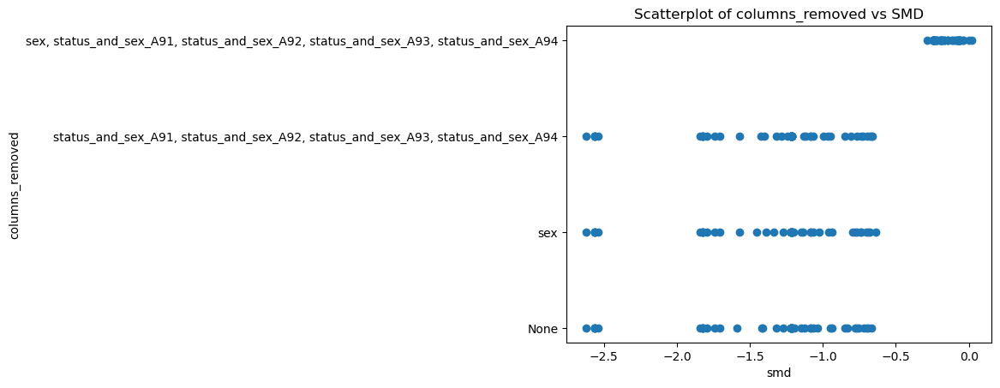

class_weight


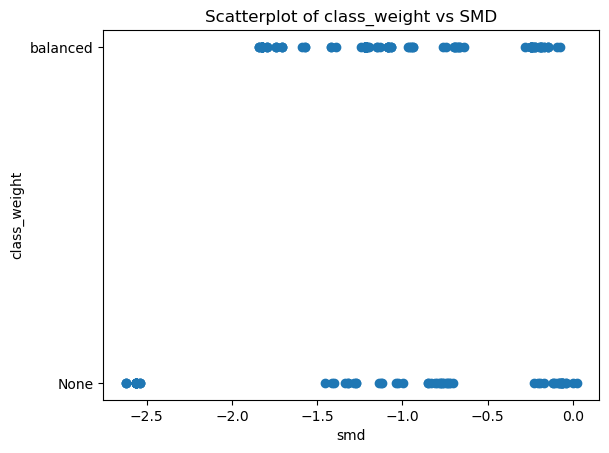

max_depth


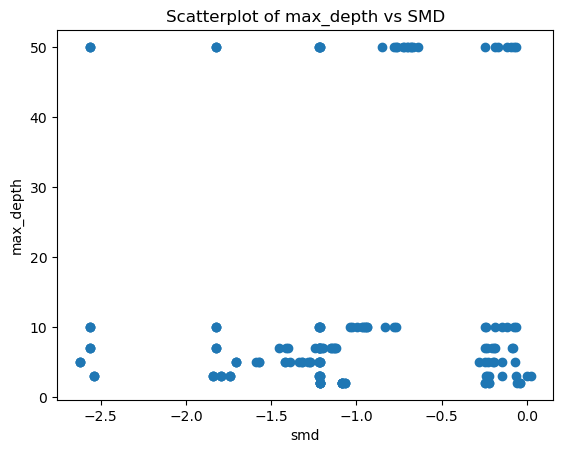

criterion


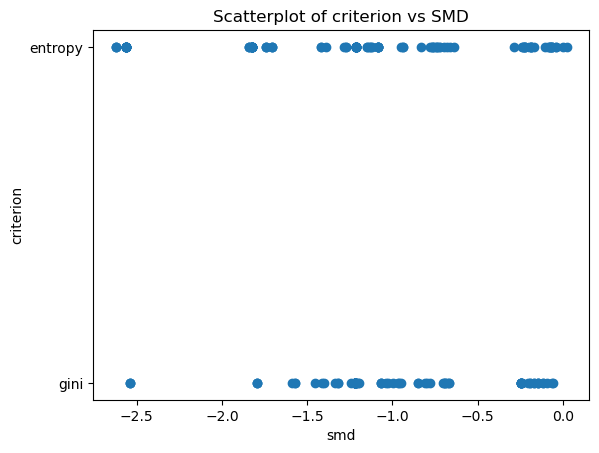

ccp_alpha


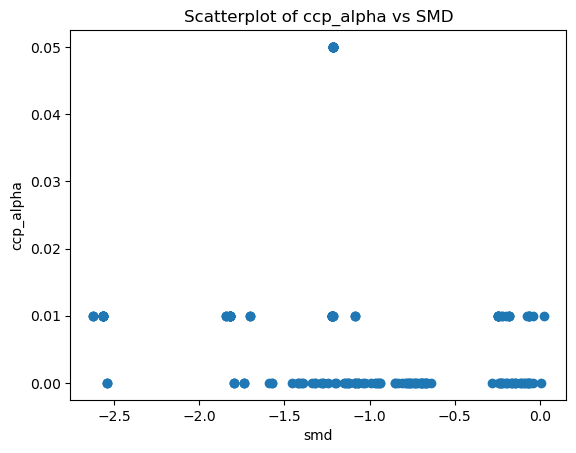

In [198]:
biased_kpi['class_weight'] = biased_kpi['class_weight'].apply(lambda x: "None" if x == None else x)

for kpi in ['columns_removed', 'class_weight', 'max_depth', 'criterion', 'ccp_alpha']:
    print(kpi)

    plt.scatter(biased_kpi["smd"], biased_kpi[kpi]  )
    plt.title(f'Scatterplot of {kpi} vs SMD')
    plt.xlabel("smd")
    plt.ylabel(kpi)
    plt.show()
    

In [199]:
X_train

,checking_account_value,duration,credit_amount,bonds,present_employment_since,rate_percentange_on_salary,present_residence_since,age,n_bank_existing_credits,n_people_liable,...,Other_installment_plans_A141,Other_installment_plans_A142,Other_installment_plans_A143,housing_A151,housing_A152,housing_A153,job_A171,job_A172,job_A173,job_A174
29,1,60,6836,0,7,3,4,63,2,1,...,0,0,1,0,1,0,0,0,1,0
535,3,21,2319,0,0,2,1,33,1,1,...,0,0,1,1,0,0,0,0,1,0
695,0,6,1236,500,1,2,4,50,1,1,...,0,0,1,1,0,0,0,0,1,0
557,0,21,5003,-1,1,1,4,29,2,1,...,1,0,0,0,1,0,0,0,1,0
836,0,12,886,-1,1,4,2,21,1,1,...,0,0,1,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,0,18,6458,0,7,2,4,39,2,2,...,1,0,0,0,1,0,0,0,0,1
270,0,18,2662,-1,4,4,3,32,1,1,...,0,0,1,0,1,0,0,0,1,0
860,0,24,5804,100,1,4,2,27,2,1,...,0,0,1,0,1,0,0,0,1,0
435,2,12,1484,-1,1,2,1,25,1,1,...,0,0,1,0,1,0,0,0,1,0


In [203]:
X_train.iloc[[29, 106]].index

Int64Index([536, 334], dtype='int64')

In [222]:
biased_df_01 = create_biased_df(df,  biased_fraction = 0.1)

Adverse Impact Ratio (AIR): 0.7582907750985842
Standardized Mean Difference -0.3693988258965304


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1501413605.py:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  biased_indices = np.random.choice(biased_df[biased_df['sex'] == 0][biased_df['credit_risk'] != 0].index,


In [223]:
biased_df_01_encoded = encode_all(biased_df_01)

X_biased_df_01 = biased_df_01_encoded.drop('credit_risk', axis=1)
y_biased_df_01 = biased_df_01_encoded['credit_risk']


X_train_01, X_test_01, y_train_01, y_test_01 = train_test_split(X_biased_df_01, y_biased_df_01, test_size=0.2, random_state=42)

In [224]:
result = dct_validation(X_train_01, y_train_01)

biased_kpi = pd.DataFrame(result)

biased_kpi.describe()

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will b

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: Undefin

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: User

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_di

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: Undefin

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: User

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2351: RuntimeWarning: invalid value encountered in multiply
  lower_bound = _a * scale + loc
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2352: RuntimeWarning: invalid value encountered in multiply
  upper_bound = _b * scale + loc
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key w

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_di

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_di

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encounte

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to mat

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argument 'alpha' for method 'interval' is deprecated and wil be removed in SciPy 1.11.0. Use first positional argument or keyword argument 'confidence' instead.
  return st.t.interval(alpha=alpha,
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:2351: RuntimeWarning: invalid value encountered in multiply
  lower_bound = _a * scale + loc
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sci

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\109952704.py:5: DeprecationWarning: Use of keyword argum

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encounter

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:24: RuntimeWarning: invalid value encountered in double_scalars
  AIR_outcome = pop_pos_rate / control_pos_rate
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined 

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: Undefin

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: Undefin

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed t

C:\Users\s.crispino\AppData\Local\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\145480815.py:14: RuntimeWarning: invalid value encountered in double_scalars
  smd = (pop_mean - control_mean) / np.sqrt((pop_std**2 + control_std**2) / 2)
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\

,max_depth,ccp_alpha,accuracy,specificity,precision,recall,f1,smd,air_outcome,air_out_accuracy
count,576.000000,672.000000,672.000000,672.000000,672.000000,672.000000,672.000000,212.000000,476.000000,672.000000
mean,12.833333,0.135000,0.557509,0.485779,0.514701,0.593363,0.535674,-0.246261,0.925486,1.085945
std,16.841357,0.119637,0.140743,0.410548,0.316283,0.402670,0.334665,0.130948,0.103764,0.429889
min,2.000000,0.000000,0.333750,0.000000,0.000000,0.000000,0.000000,-0.582129,0.582887,0.735944
25%,3.000000,0.010000,0.378750,0.000000,0.167875,0.103302,0.127638,-0.311371,0.855344,0.745814
50%,6.000000,0.125000,0.641875,0.471296,0.666250,0.735360,0.731851,-0.247920,1.000000,0.848906
75%,10.000000,0.250000,0.666250,0.930556,0.734722,1.000000,0.799686,-0.123326,1.000000,1.627778
max,50.000000,0.300000,0.682500,1.000000,0.829610,1.000000,0.799686,0.035920,1.020509,1.769115


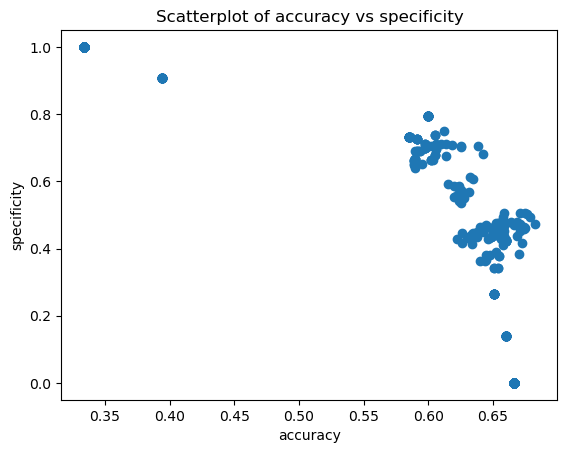

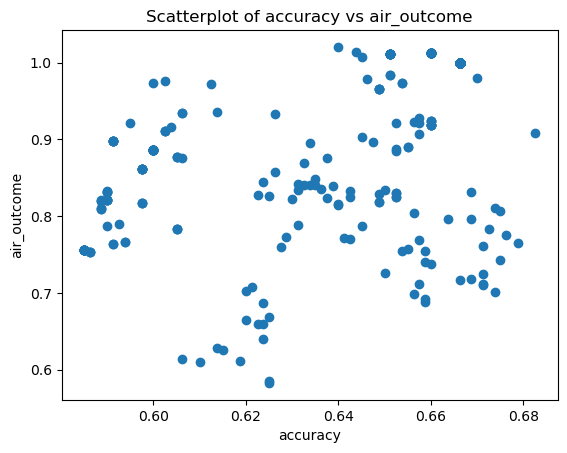

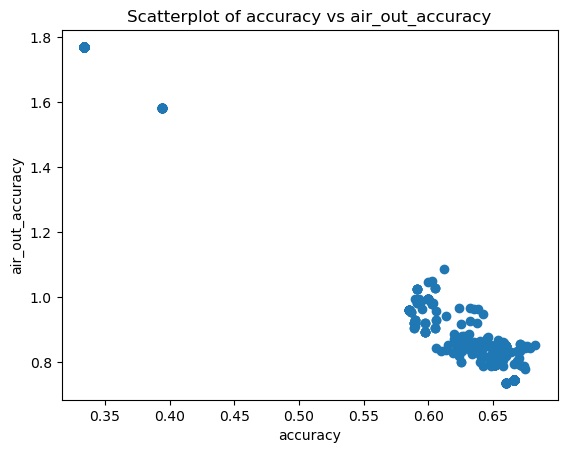

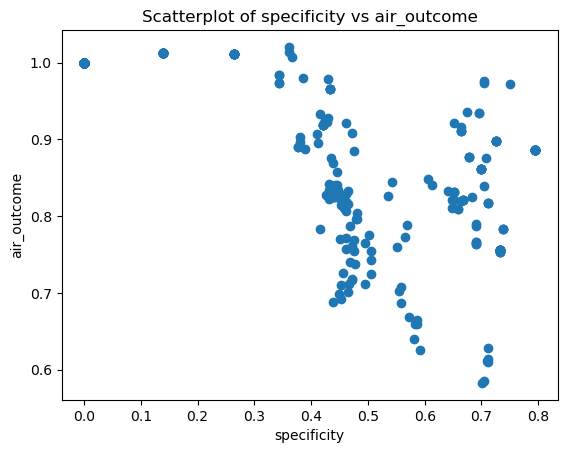

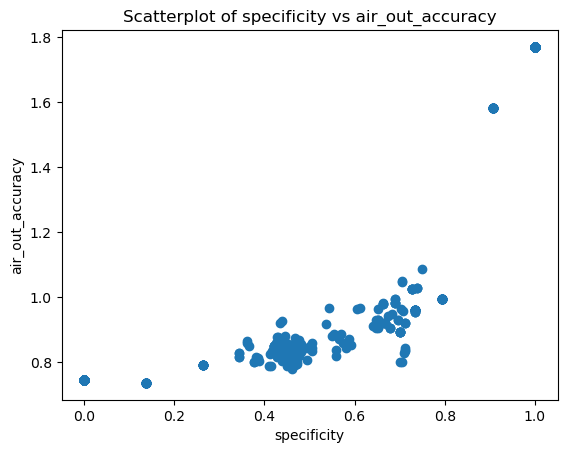

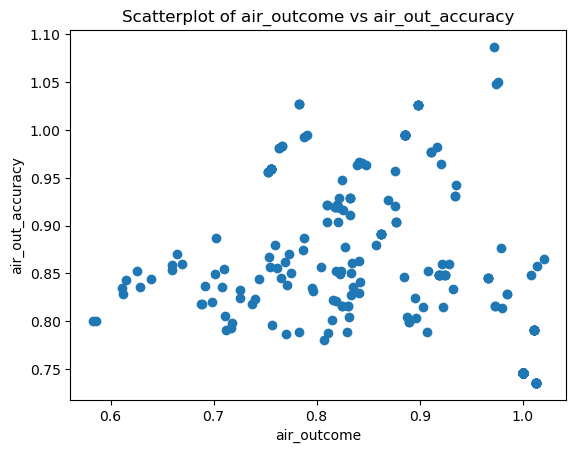

In [225]:
kpis = ['accuracy', 'specificity', 'air_outcome', 'air_out_accuracy']

done_1 = []

for col in kpis:
    
    for col_2 in kpis:
        if col !=  col_2 and col_2 not in done_1:
            plt.scatter(biased_kpi[col], biased_kpi[col_2] )
            plt.title(f'Scatterplot of {col} vs {col_2}')
            plt.xlabel(col)
            plt.ylabel(col_2)
            plt.show()
            
            done_1.append(col)

In [226]:
biased_kpi[biased_kpi['specificity'] >= 0.63]\
    [biased_kpi['accuracy'] >= 0.62]\
    [biased_kpi['air_outcome'] > 0.79]\
    [biased_kpi['air_out_accuracy'] > 0.79]

C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\511866312.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  biased_kpi[biased_kpi['specificity'] >= 0.63]\


,columns_removed,class_weight,max_depth,criterion,ccp_alpha,accuracy,specificity,precision,recall,f1,...,air_outcome,air_out_accuracy,accuracy_confidence,specificity_confidence,precision_confidence,recall_confidence,f1_confidence,smd_confidence,air_outcome_confidence,air_out_accuracy_confidence
612,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,5.0,gini,0.0,0.63875,0.703846,0.806275,0.605975,0.689718,...,0.838892,0.963425,"(0.6130859643057718, 0.6644140356942281)","(0.6491956560530094, 0.7584966516392981)","(0.7778316843049135, 0.8347184673069864)","(0.5710429109380584, 0.6409067745965326)","(0.6632578247269126, 0.7161776454856729)","(-0.31314410467112647, -0.04039684733607088)","(0.7152596385458598, 0.9625248304829614)","(0.8908895166829544, 1.0359603368463406)"
618,"sex, status_and_sex_A91, status_and_sex_A92, s...",balanced,5.0,entropy,0.0,0.64250,0.682479,0.801345,0.623061,0.697434,...,0.824765,0.947329,"(0.619032653986641, 0.6659673460133589)","(0.6117527862024625, 0.7532044787548023)","(0.7709010246481023, 0.8317898476268104)","(0.5820745583761251, 0.6640470349152794)","(0.6727741904242799, 0.7220931195351052)","(-0.31933547357801245, -0.0855685112052069)","(0.7268085596138654, 0.9227219188725653)","(0.8940880732316888, 1.000570315828637)"


In [227]:
clf = DecisionTreeClassifier(class_weight='balanced', 
                                             max_depth=5, 
                                             ccp_alpha=0.0, 
                                             criterion='entropy')

columns_to_removed = ['sex', 'status_and_sex_A91', 'status_and_sex_A92', 'status_and_sex_A93', 'status_and_sex_A94']

X_train_biased_copy = X_train_01.copy()
X_test_biased_copy = X_test_01.copy()

X_train_biased_copy = X_train_biased_copy.drop(columns=columns_to_removed)
X_test_biased_copy = X_test_biased_copy.drop(columns=columns_to_removed)
# X_train_025, X_test_025, y_train_025, y_test_025

clf.fit(X_train_biased_copy, y_train_025)

predictions = clf.predict(X_test_biased_copy)

# Performance Metrics
specificity, accuracy, precision, recall, f1 = get_metrics(y_test_01, predictions)

# Fairness Metrics
conc_result_df = get_final_result_df(y_test_01, predictions, X_test_01)                        
smd = standardized_mean_difference(conc_result_df, 'sex', 0, 1, 'prediction')
air_outcome, air_out_accuracy = adverse_impacat_ratio(conc_result_df, 'sex', 0, 1, 'prediction', 1)

print(f"specificity: {specificity}")
print(f"accuracy: {accuracy}")
print(f"precision: {precision}")
print(f"recall: {recall}")
print(f"f1: {f1}")
print(f"smd: {smd}")
print(f"air_outcome: {air_outcome}")
print(f"air_out_accuracy: {air_out_accuracy}")
print(f"confusion matrix: \n{confusion_matrix(y_test_biased, predictions)}")

specificity: 0.796875
accuracy: 0.64
precision: 0.8555555555555555
recall: 0.5661764705882353
f1: 0.6814159292035398
smd: 0.13956356928455665
air_outcome: 1.161290322580645
air_out_accuracy: 1.0857142857142859
confusion matrix: 
[[53 18]
 [57 72]]


C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_pos_target = control_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  control_correct_target = control_pop[df[target]==df['label']][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_pos_target = marker_pop[df[target]==target_val][marker].count()
C:\Users\s.crispino\AppData\Local\Temp\ipykernel_4468\1757071157.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pop_correct_target = marker_pop[df[target]==df['label']][marker].count()


In [ ]:
biased_kpi['class_weight'] = biased_kpi['class_weight'].apply(lambda x: "None" if x == None else x)

for kpi in ['columns_removed', 'class_weight', 'max_depth', 'criterion', 'ccp_alpha']:
    print(kpi)

    plt.scatter(biased_kpi["smd"], biased_kpi[kpi]  )
    plt.title(f'Scatterplot of {kpi} vs SMD')
    plt.xlabel("smd")
    plt.ylabel(kpi)
    plt.show()
    